In [10]:
%matplotlib widget
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import toeplitz
from static_1Dfunction import *

In [11]:
# model parameters
c = 10.0;
gmax = 0.05;
k1 = 5.0;
k2 = 5.0;
d = 0.25;
alpha = 0.2;
w0 = 0.2;
rw = 0.2;
DP = 0.1;
DW = 0.1;
DO = 100;
param={'c':c,'gmax':gmax,'k1':k1,'d':d,'DP':DP,'alpha':alpha,'k2':k2,'w0':w0,'rw':rw,'DW':DW,'DO':DO}


In [12]:
def plot_sols(sols,m):
    max_P=np.zeros(len(sols))
    mean_P=np.zeros(len(sols))
    Rains=np.zeros(len(sols))
    for i in range(len(sols)):
        max_P[i]=np.max(sols[i][1])
        mean_P[i]=np.mean(sols[i][1])
        Rains[i]=sols[i][0]
    print(L)
    fig,ax=plt.subplots(1,4,figsize=(20,5))
    #ax.plot(Rains,max_P,color='red',label='Maximum biomass')
    #ax.plot(Rains,mean_P,color='black',label='Mean biomass')
    ax[0].plot(Rains,max_P,color='red',marker='.',label='Maximum biomass')
    ax[0].plot(Rains,mean_P,color='black',marker='.',label='Mean biomass')
    ax[0].plot(sols[0][0],np.max(sols[0][1]),'o',color='red',label='Maximum biomass')
    ax[0].plot(sols[0][0],np.mean(sols[0][1]),'o',color='black',label='Mean biomass')
    ax[0].plot(sols[m][0],np.max(sols[m][1]),'^',color='green',label='Maximum biomass')
    ax[0].plot(sols[m][0],np.mean(sols[m][1]),'v',color='green',label='Mean biomass')
    ax[0].set_xlim(0,1.5)
    ax[0].set_ylim(0,20)
    ax[0].legend()
    ax[1].plot(x,sols[m][1])
    ax[1].set_xlabel('x')
    ax[1].set_ylabel('B')
    #ax[1].set_ylabel('Rain')
    ax[1].set_ylim((0,20))
    ax[2].plot(x,sols[m][2])
    ax[2].set_xlabel('x')
    ax[2].set_ylabel('W')
    ax[3].plot(x,sols[m][3])
    ax[3].set_xlabel('x')
    ax[3].set_ylabel('O')
    return()


(2604, 7)


Text(0, 0.5, '$\\kappa$')

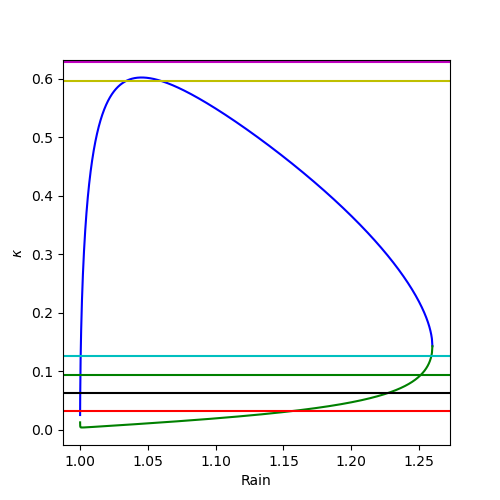

In [13]:
kappa=np.flip(np.loadtxt('Guesses.dat'),axis=0)
print(kappa.shape)
L=200
fig=plt.figure(figsize=(5,5))
ax=fig.add_subplot(1,1,1)
ax.plot(kappa[:,0],kappa[:,1],'b')
ax.plot(kappa[:,0],kappa[:,2],'g')
ax.axhline(2*np.pi/L,color='r',label='L=200 m')
ax.axhline(2*2*np.pi/L,color='k',label='L=200 m')
ax.axhline(3*2*np.pi/L,color='g',label='L=200 m')
ax.axhline(4*2*np.pi/L,color='c',label='L=200 m')
ax.axhline(19*2*np.pi/L,color='y',label='L=200 m')
ax.axhline(20*2*np.pi/L,color='m',label='L=200 m')
ax.set_xlabel('Rain')
ax.set_ylabel(r'$\kappa$')

In [5]:
k=0
print((kappa[k,0]))
print((kappa[k,1]))
print(2*np.pi/L)

1.00003
0.025339826550936723
0.031415926535897934


In [5]:

def find_kappa_U(L,n,min_Rain,max_Rain,kappa):
    valmax = max_Rain
    valmin = min_Rain
    val = (valmax+valmin)/2
    while abs(2*np.pi/np.interp(val,kappa[:,0],kappa[:,1]) - L/n) > 1e-10:
        if np.interp(val,kappa[:,0],kappa[:,1]) > n*2*np.pi/L:
            valmax = val
        else: 
            valmin = val
        val = (valmax+valmin)/2
        print(val)
    return(val)



### First mode with low rainfall


In [7]:
valmax = 1.01
valmin = np.min(kappa[:,0])
print(valmin)
n_lmb=1


def find_kappa_U(L,n,min_Rain,max_Rain,kappa):
    valmax = max_Rain
    valmin = min_Rain
    val = (valmax+valmin)/2
    while abs(2*np.pi/np.interp(val,kappa[:,0],kappa[:,1]) - L/n) > 1e-9:
        if np.interp(val,kappa[:,0],kappa[:,1]) > n*2*np.pi/L:
            valmax = val
        else: 
            valmin = val
        val = (valmax+valmin)/2
        #print(val)
        #print(abs(2*np.pi/np.interp(val,kappa[:,0],kappa[:,1]) - L/n))
    return(val)


R0=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R0)

#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)
N=200

1.00003
1.0000379241540882


200.00000000012565
0.03141592653587819
1.0000379241540882


Text(0, 0.5, 'O')

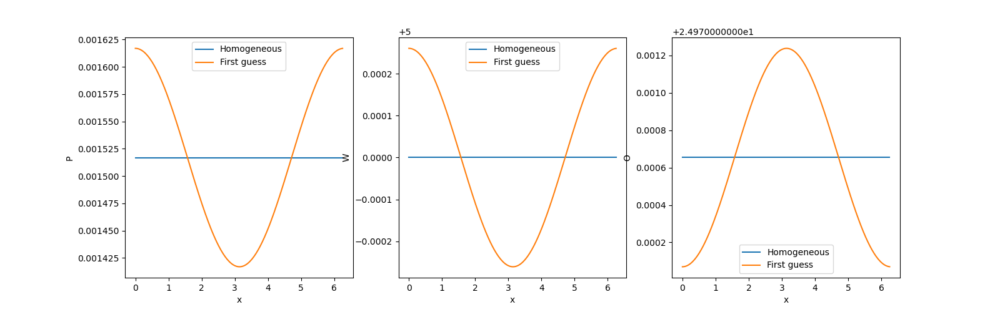

In [8]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R0,kappa,mode="U",n_lmb=n_lmb,eps=0.0001,N=N)
print(L)
print(k)
print(Rain)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [9]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R0,kappa,mode="U",n_lmb=n_lmb,eps=0.001,N=N)
mode='one'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000012565
6.482413539288245e-08 9.85641738531623e-11


1.0000279241540881


Text(0, 0.5, 'O')

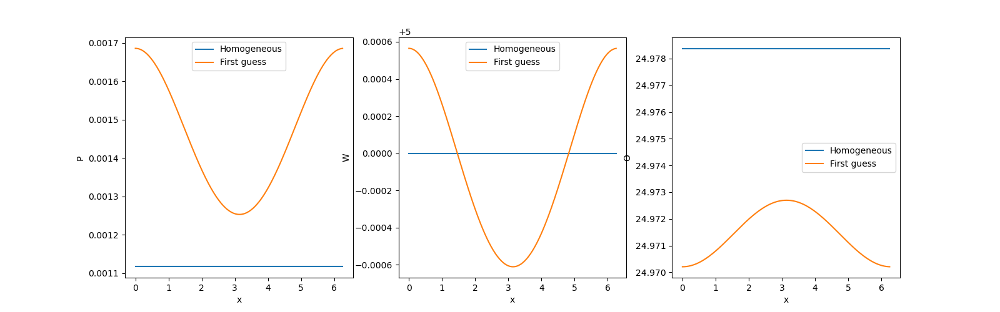

In [10]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [11]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.99:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000000012565


()

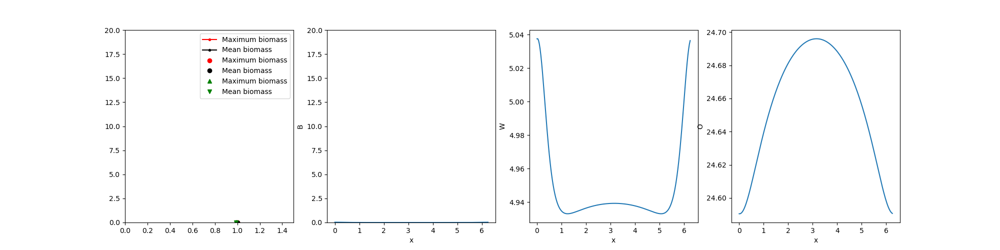

In [12]:
plot_sols(sols,-1)

In [13]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [14]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.9899279241540893


In [15]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.51:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000012565


()

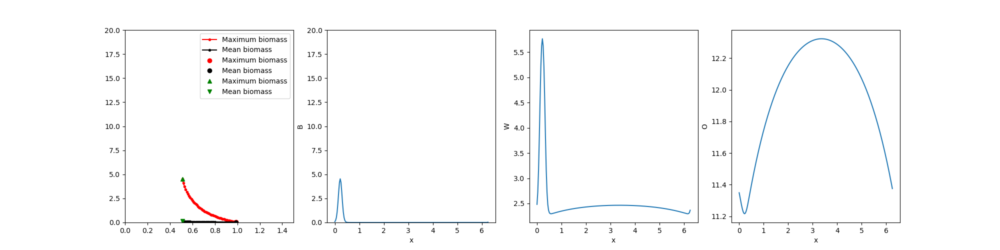

In [16]:
plot_sols(sols2,-1)

In [17]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [18]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.5099279241540888


In [19]:
Rain,Pg,Wg,Og = sols3[0]
while Rain > 0.463:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000012565


()

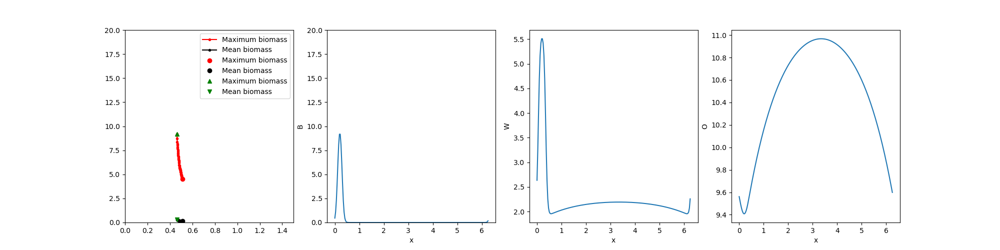

In [20]:
plot_sols(sols3,-1)

In [21]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [22]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.0001
Pg = Pg + 0.7
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.4630279241540888


In [23]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 0.49:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols4.append([Rain,Pg,Wg,Og])


200.00000000012565


()

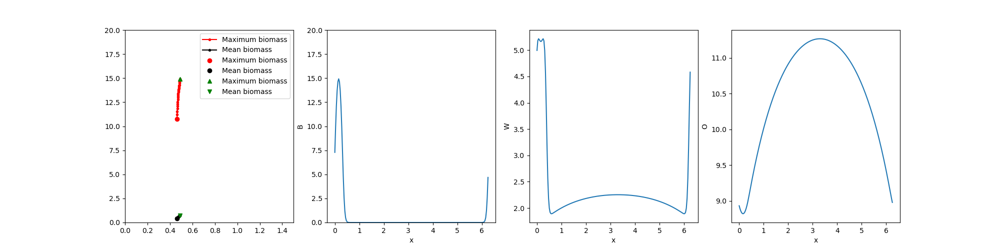

In [24]:
plot_sols(sols4,-1)

In [25]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [26]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


0.4900279241540888


In [27]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 0.60:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.00000000012565


()

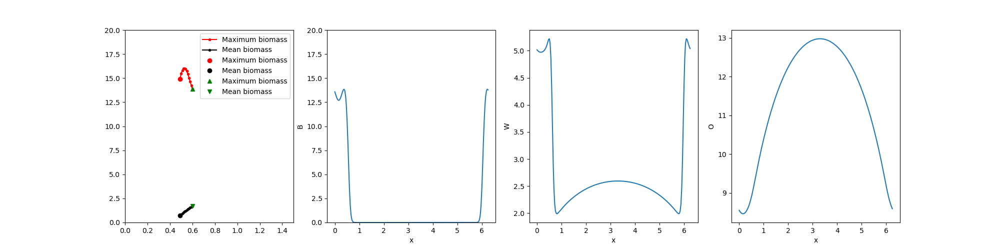

In [28]:
plot_sols(sols5,-1)

In [29]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [30]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


0.6000279241540889


In [31]:
Rain,Pg,Wg,Og = sols6[0]
while Rain < 0.6113:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


200.00000000012565


()

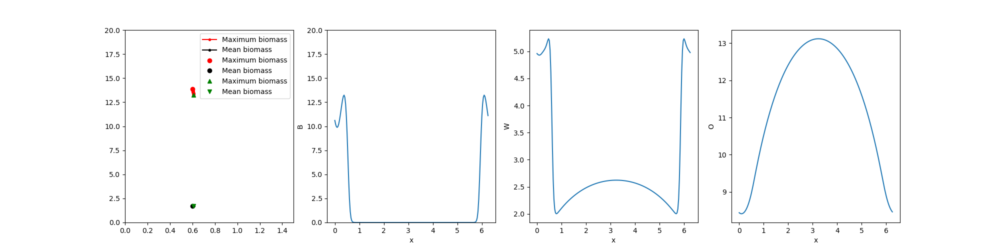

In [32]:
plot_sols(sols6,-1)

In [33]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

In [34]:
Rain,Pg,Wg,Og = sols6[-1]
Rain = Rain - 0.001
Pg = Pg - .5
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols7 = [[Rain,Pnew,Wnew,Onew]]


0.6103279241540877


In [35]:
Rain,Pg,Wg,Og = sols7[0]
while Rain > 0.55:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols7.append([Rain,Pg,Wg,Og])


200.00000000012565


()

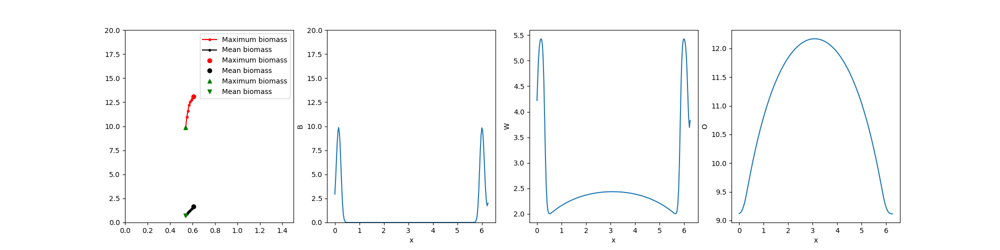

In [36]:
plot_sols(sols7,-1)

In [37]:
save_RvsPWO(sols7,'sols7','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','O',mode+'R0',int(np.round(L)))

In [38]:
Rain,Pg,Wg,Og = sols7[-1]
Rain = Rain - 0.000
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols8 = [[Rain,Pnew,Wnew,Onew]]


0.5403279241540876


In [39]:
Rain,Pg,Wg,Og = sols8[0]
while Rain > 0.5339:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols8.append([Rain,Pg,Wg,Og])


200.00000000012565


()

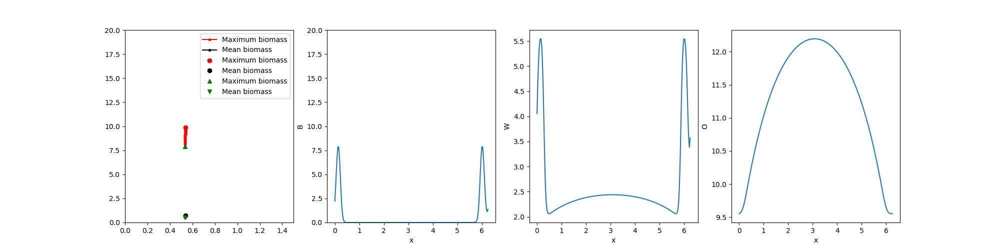

In [40]:
plot_sols(sols8,-1)

In [41]:
save_RvsPWO(sols8,'sols8','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','O',mode+'R0',int(np.round(L)))

In [42]:
Rain,Pg,Wg,Og = sols8[-1]
Rain = Rain + 0.01
Pg = Pg - 0.655
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols9 = [[Rain,Pnew,Wnew,Onew]]


0.5438279241540883


In [43]:
Rain,Pg,Wg,Og = sols9[0]
while Rain < 0.560:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols9.append([Rain,Pg,Wg,Og])


200.00000000012565


()

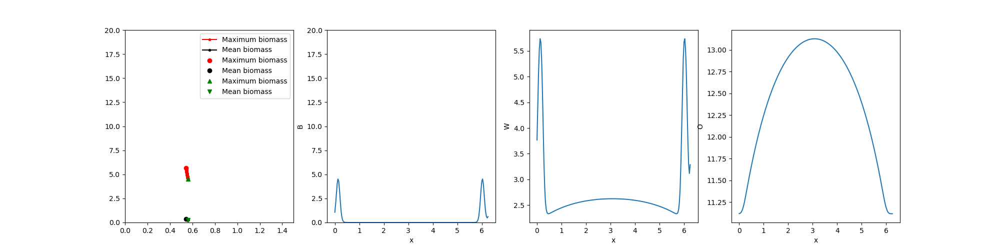

In [44]:
plot_sols(sols9,-2)

In [45]:
save_RvsPWO(sols9,'sols9','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','O',mode+'R0',int(np.round(L)))

In [46]:
Rain,Pg,Wg,Og = sols9[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols10 = [[Rain,Pnew,Wnew,Onew]]


0.5600279241540865


In [47]:
Rain,Pg,Wg,Og = sols10[0]
while Rain < 0.95:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols10.append([Rain,Pg,Wg,Og])


200.00000000012565


()

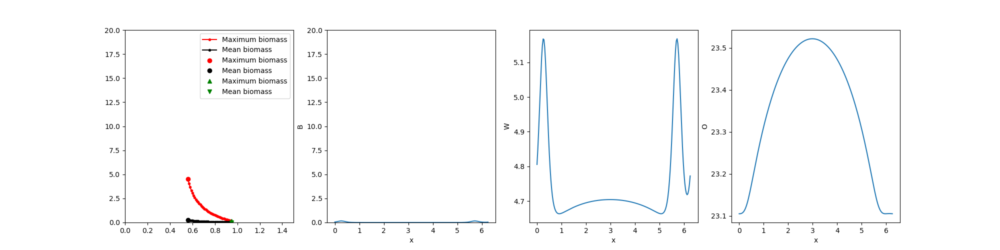

In [48]:
plot_sols(sols10,-1)

In [49]:
save_RvsPWO(sols10,'sols10','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','O',mode+'R0',int(np.round(L)))

In [50]:
Rain,Pg,Wg,Og = sols10[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols11 = [[Rain,Pnew,Wnew,Onew]]


0.9500279241540869


In [51]:
Rain,Pg,Wg,Og = sols11[0]
while Rain < 1.:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols11.append([Rain,Pg,Wg,Og])


200.00000000012565


()

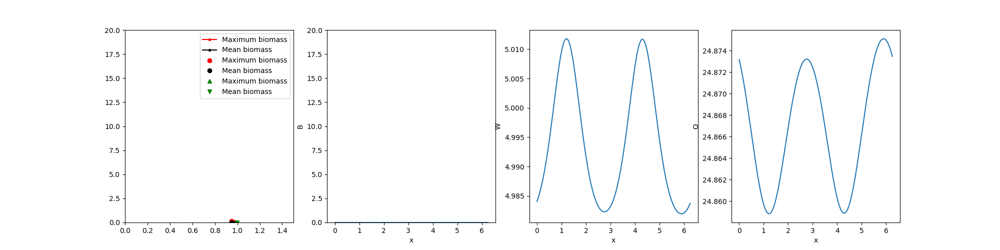

In [52]:
plot_sols(sols11,-2)

In [53]:
save_RvsPWO(sols11,'sols11','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols11,'sols11','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols11,'sols11','O',mode+'R0',int(np.round(L)))

### Second mode with low rainfall


In [184]:
kappa=np.flip(np.loadtxt('Guesses.dat'),axis=0)

print('done')
L=200
n_lmb=2
N=200

valmin = np.min(kappa[:,0])
valmax = 1.01

R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)


done
1.0001154019495035


199.99999999982188
0.06283185307185182


Text(0, 0.5, 'O')

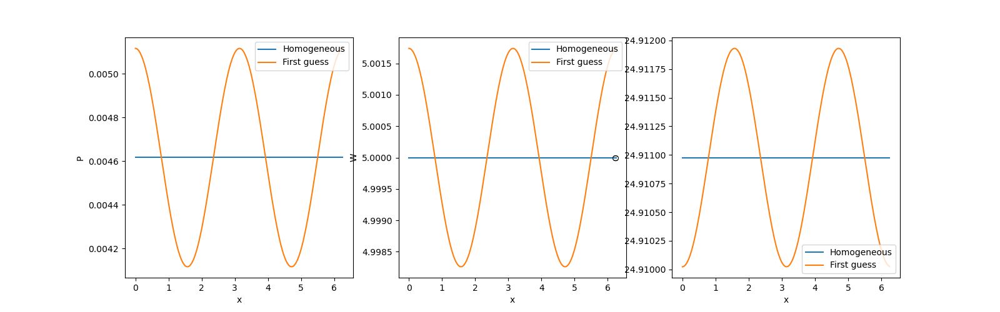

In [185]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.0005,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [186]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='two'
Rain = Rain-0.0001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999982188
5.416338844099755e-08 9.297393561887772e-11


1.0000154019495036


Text(0, 0.5, 'O')

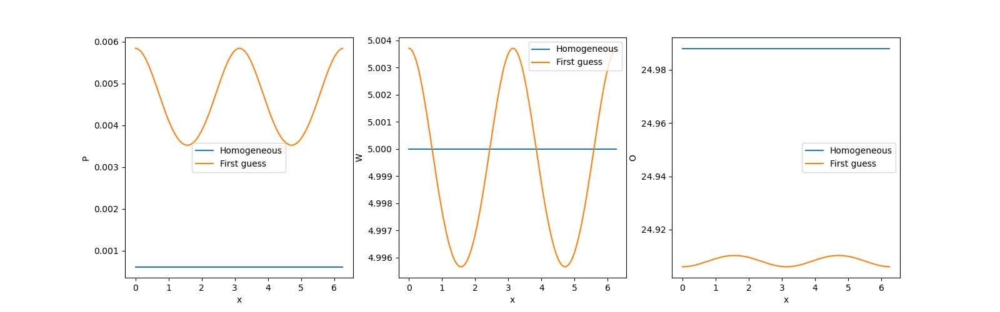

In [187]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [188]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.5:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols.append([Rain,Pg,Wg,Og])


199.99999999982188


()

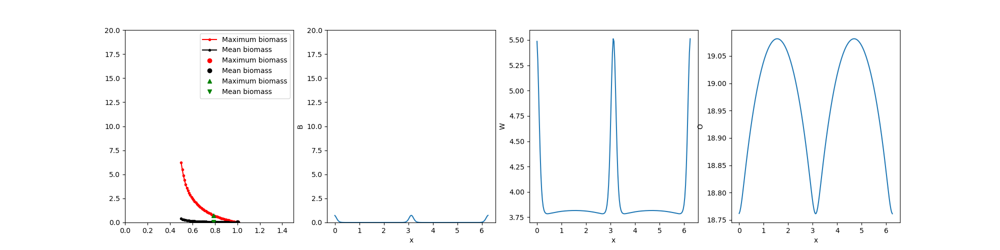

In [198]:
plot_sols(sols,-30)

In [190]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [191]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

sols2 = [[Rain,Pnew,Wnew,Onew]]


In [192]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.488:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999982188


()

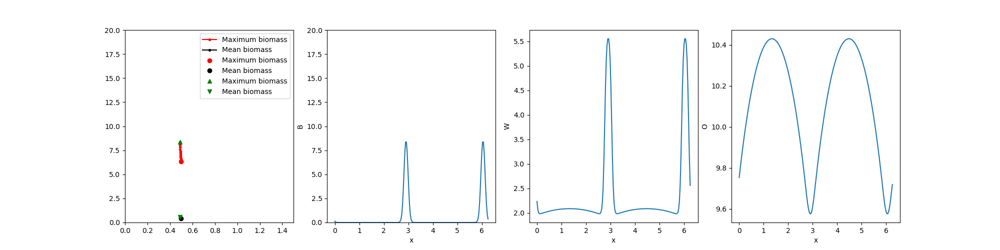

In [193]:
plot_sols(sols2,-1)

In [194]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [203]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 0.8
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]

0.4880154019495031


In [206]:
Rain,Pg,Wg,Og = sols3[-1]
while Rain < 0.716:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-3,crit_source = 1e-4)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999982188


()

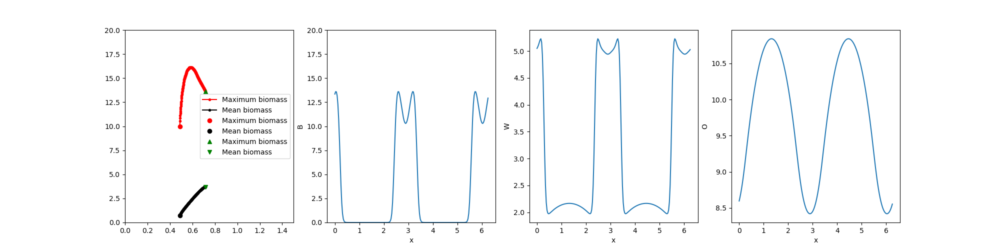

In [207]:
plot_sols(sols3,-1)

In [209]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [210]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain-+ 0.001
Pg = Pg - 0.5
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]

0.7150154019495033


In [211]:
Rain,Pg,Wg,Og = sols4[-1]
while Rain > 0.70:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
    sols4.append([Rain,Pg,Wg,Og])


199.99999999982188


()

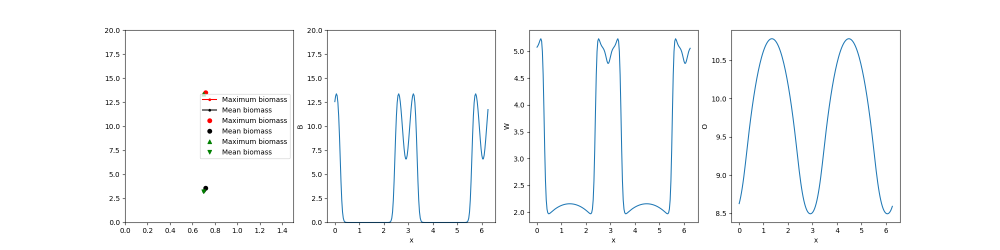

In [212]:
plot_sols(sols4,-1)

In [213]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [214]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain-+ 0.00
Pg = Pg - 0.
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]

0.6990154019495033


In [215]:
Rain,Pg,Wg,Og = sols5[-1]
while Rain > 0.58:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
    sols5.append([Rain,Pg,Wg,Og])


199.99999999972087


()

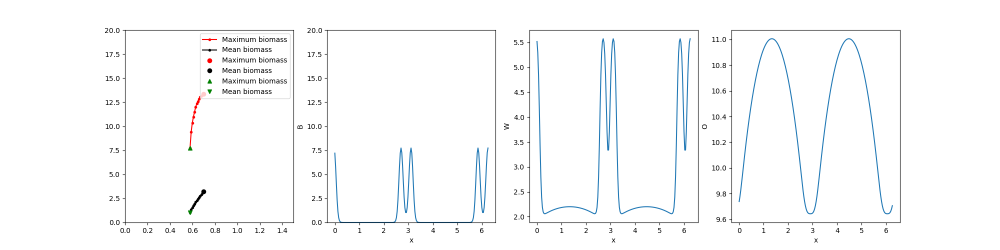

In [260]:
plot_sols(sols5,-1)

In [217]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [276]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain+ 0.0001
Pg = Pg - 0.7555
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]

0.5791154019495032


In [277]:
Rain,Pg,Wg,Og = sols6[-1]
while Rain < 0.99:
    Rain = Rain+0.02
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-8)
    sols6.append([Rain,Pg,Wg,Og])


0.5791154019495032
0.5991154019495032
0.9991154019495035
199.99999999972087


()

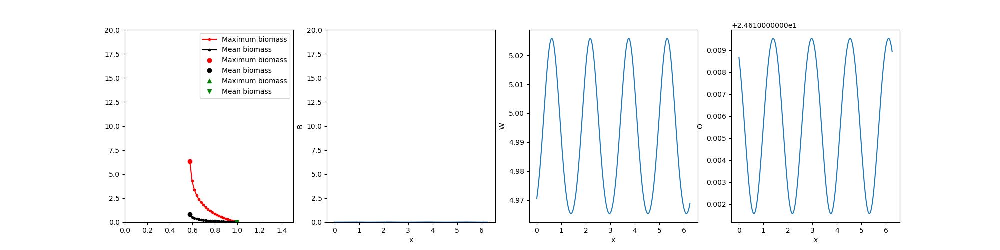

In [295]:
print(sols6[0][0])
print(sols6[1][0])
print(sols6[-1][0])
plot_sols(sols6,-1)

In [299]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Third mode with low rainfall


In [14]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=3
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0002458038687063


199.99999999991672
0.09424777960773303


Text(0, 0.5, 'O')

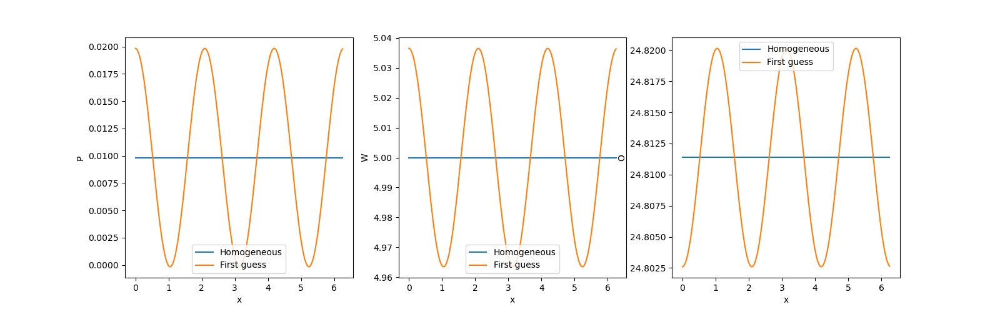

In [15]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [16]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='three'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999991672
9.74372245110544e-07 3.379825129894894e-11


1.0002358038687063


Text(0, 0.5, 'O')

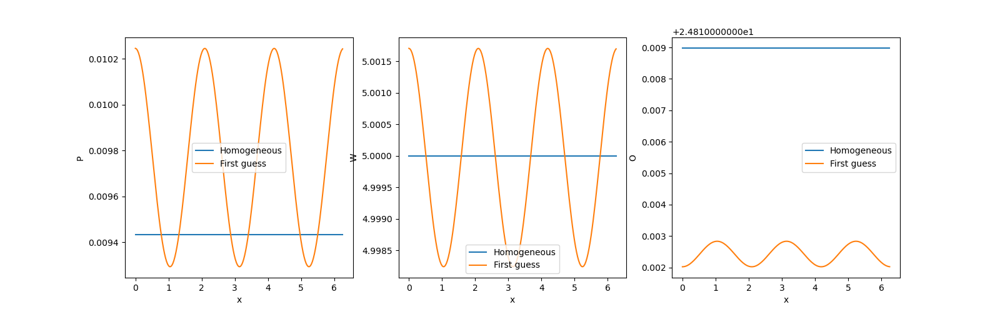

In [17]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [ ]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.55:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999999991672


()

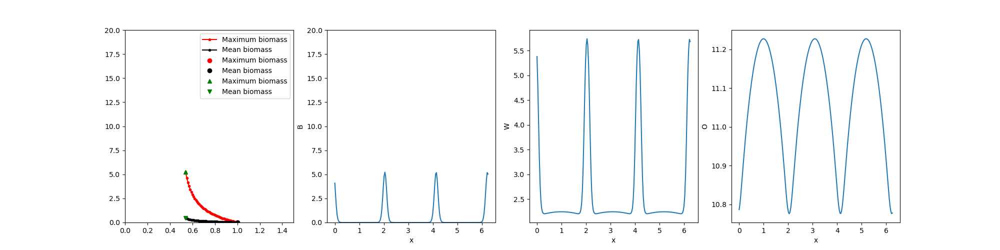

In [19]:
plot_sols(sols,-1)

In [20]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [56]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.5402358038687058


In [57]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.5215:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999991672


()

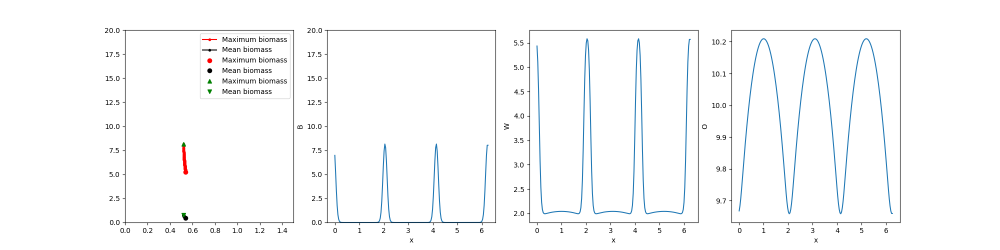

In [58]:
plot_sols(sols2,-1)

In [59]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [60]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 1
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.5215358038687079


In [61]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.55:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999991672


()

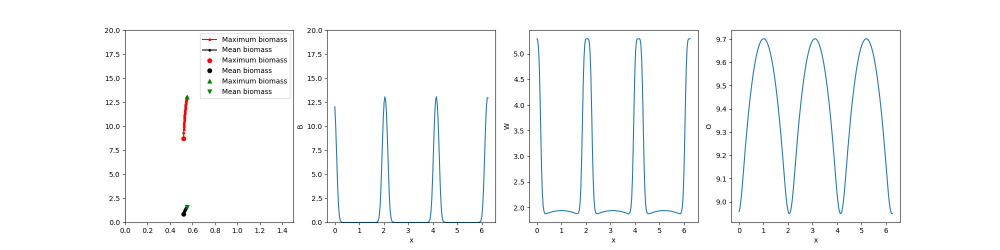

In [63]:
plot_sols(sols3,-1)

In [64]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [65]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.5505358038687079


In [66]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 0.93:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols4.append([Rain,Pg,Wg,Og])


199.99999999991672


()

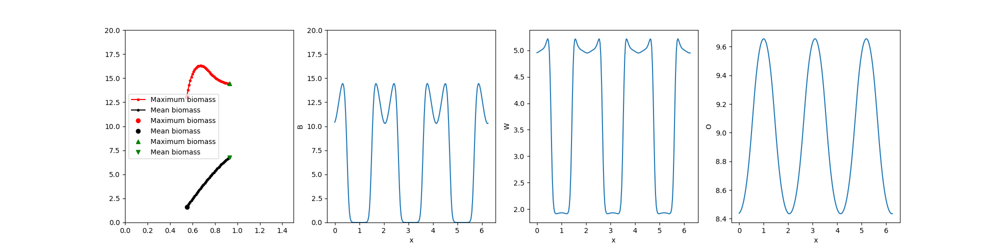

In [67]:
plot_sols(sols4,-1)

In [68]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [ ]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


In [70]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 0.935:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


199.99999999991672


()

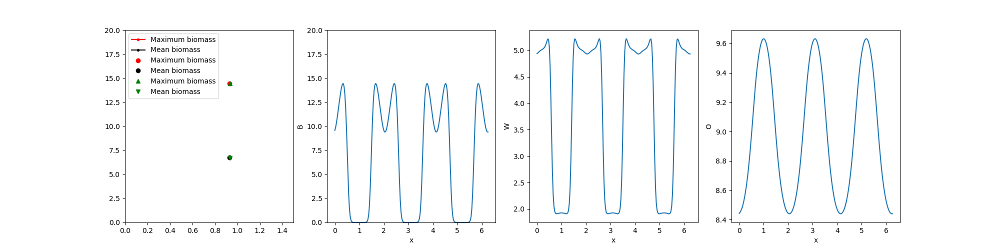

In [114]:
plot_sols(sols5,-1)

In [72]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [73]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0001
Pg = Pg - 1
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


0.9354358038687083


In [74]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 0.65:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


199.99999999991672


()

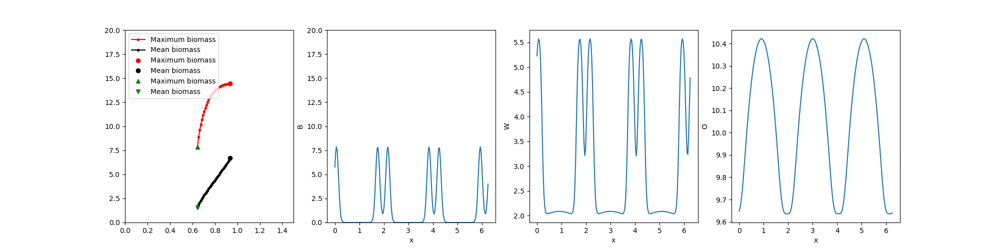

In [75]:
plot_sols(sols6,-1)

In [76]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

In [94]:
Rain,Pg,Wg,Og = sols6[-1]
Rain = Rain + 0.000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols7 = [[Rain,Pnew,Wnew,Onew]]


0.645435803868708


In [95]:
Rain,Pg,Wg,Og = sols7[0]
while Rain > 0.642:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols7.append([Rain,Pg,Wg,Og])


199.99999999991672


()

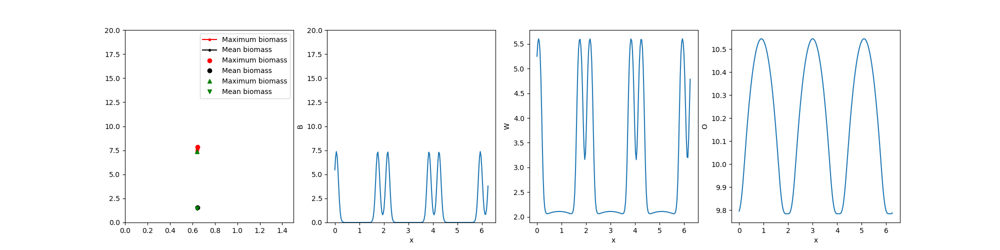

In [116]:
plot_sols(sols7,-1)

In [97]:
save_RvsPWO(sols7,'sols7','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','O',mode+'R0',int(np.round(L)))

In [125]:
Rain,Pg,Wg,Og = sols7[-1]
Rain = Rain + 0.0001
Pg = Pg - 0.948
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols8 = [[Rain,Pnew,Wnew,Onew]]


0.6420358038687084


In [126]:
Rain,Pg,Wg,Og = sols8[0]
while Rain < 0.68:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols8.append([Rain,Pg,Wg,Og])


199.99999999991672


()

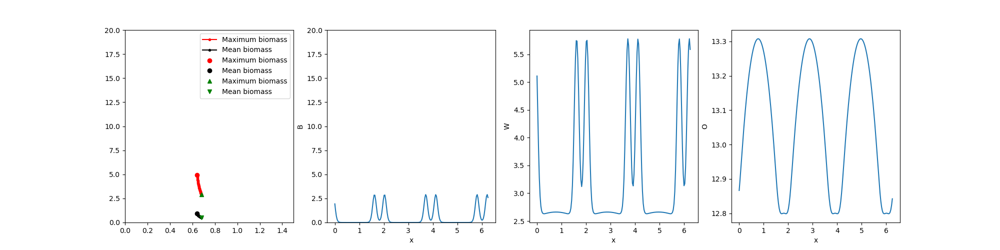

In [127]:
plot_sols(sols8,-1)

In [128]:
save_RvsPWO(sols8,'sols8','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','O',mode+'R0',int(np.round(L)))

In [139]:
Rain,Pg,Wg,Og = sols8[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols9 = [[Rain,Pnew,Wnew,Onew]]


0.6800358038687084


In [140]:
Rain,Pg,Wg,Og = sols9[0]
while Rain < 0.91:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols9.append([Rain,Pg,Wg,Og])


199.99999999991672


()

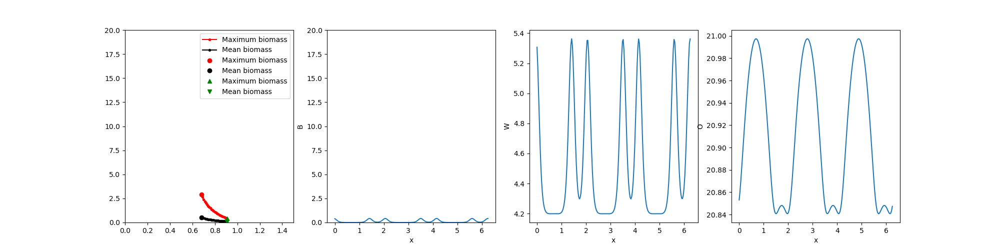

In [141]:
plot_sols(sols9,-1)

In [142]:
save_RvsPWO(sols9,'sols9','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','O',mode+'R0',int(np.round(L)))

In [143]:
Rain,Pg,Wg,Og = sols9[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols10 = [[Rain,Pnew,Wnew,Onew]]


0.9100358038687086


In [144]:
Rain,Pg,Wg,Og = sols10[0]
while Rain < 1.005:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols10.append([Rain,Pg,Wg,Og])


199.99999999991672


()

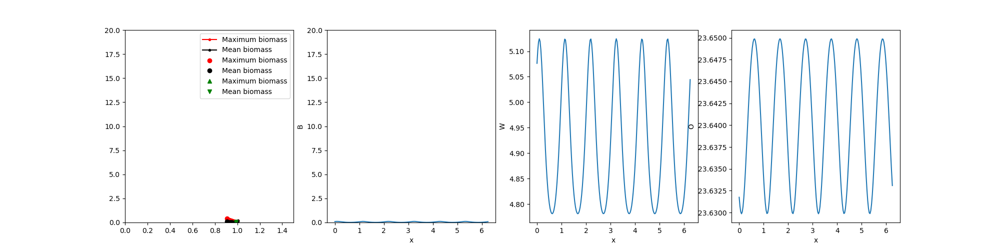

In [146]:
plot_sols(sols10,-20)

In [147]:
save_RvsPWO(sols10,'sols10','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','O',mode+'R0',int(np.round(L)))

### Fourth mode with low rainfall


In [300]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=4
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0004309016432855


200.0000000000036
0.12566370614358946


Text(0, 0.5, 'O')

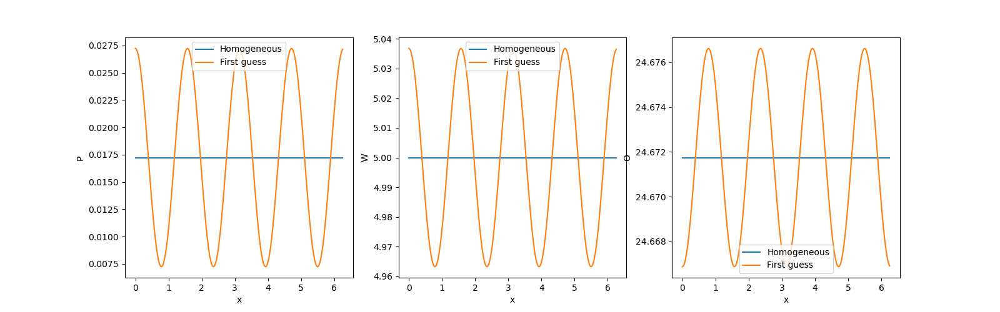

In [301]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [302]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='four'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.0000000000036
9.042016895222105e-07 4.712025741734196e-11


1.0004209016432855


Text(0, 0.5, 'O')

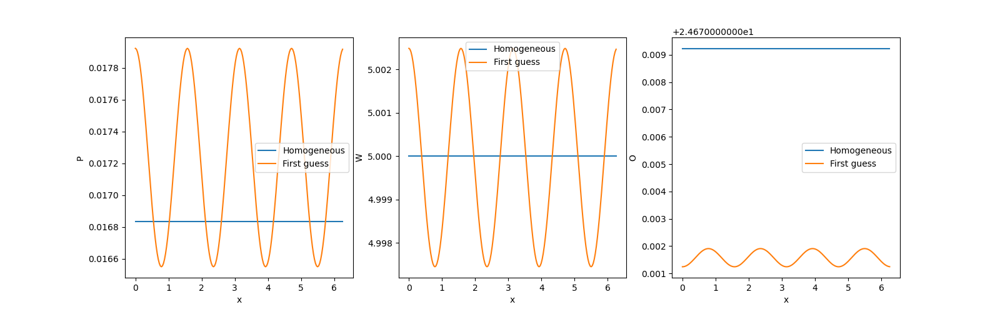

In [303]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [304]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.57:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.0000000000036


()

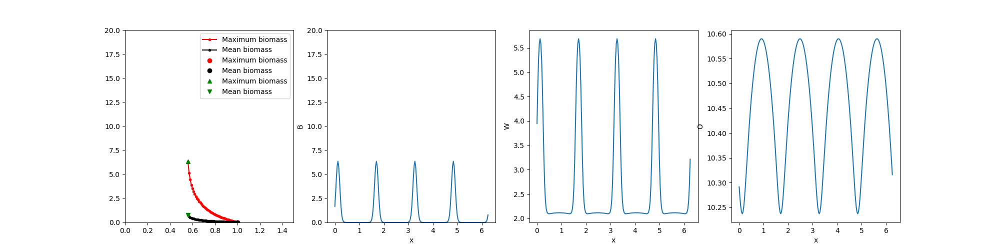

In [305]:
plot_sols(sols,-1)

In [306]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [310]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.5603209016432851


In [311]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.5583:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


200.0000000000036


()

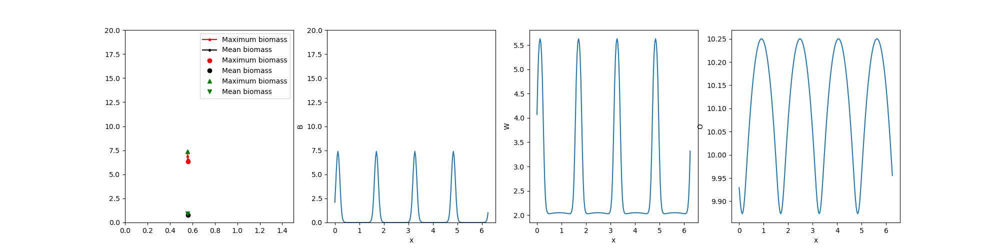

In [312]:
plot_sols(sols2,-1)

In [313]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [314]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 1
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.5574209016432851


In [315]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.62:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


200.0000000000036


()

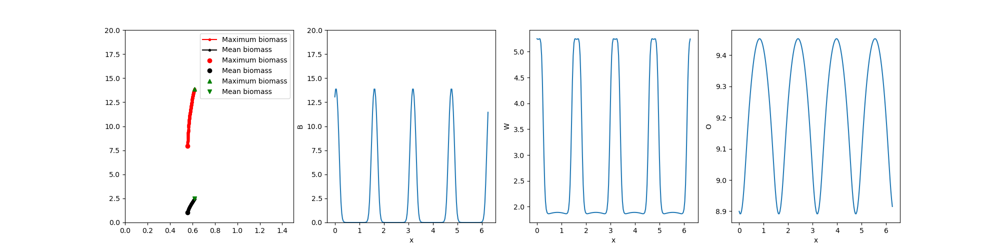

In [316]:
plot_sols(sols3,-1)

In [317]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [318]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


0.6200209016432782


In [319]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.29:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


200.0000000000036


()

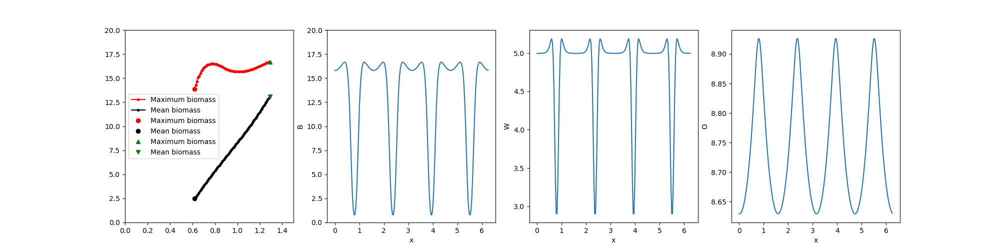

In [320]:
plot_sols(sols4,-1)

In [321]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [322]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.2900209016432787


In [323]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.311:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


200.0000000000036


()

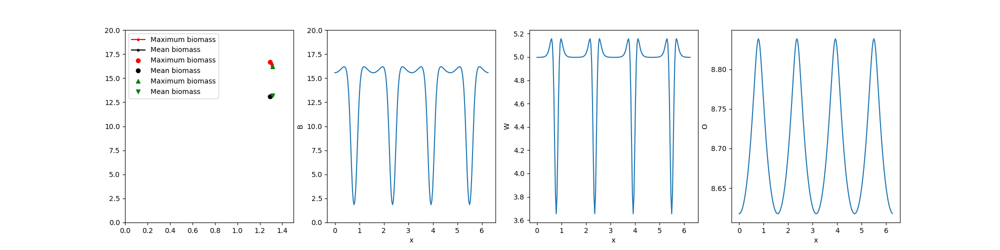

In [324]:
plot_sols(sols5,-1)

In [325]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [327]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0003
Pg = Pg - 3.
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.3107209016432764


In [328]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.25:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols6.append([Rain,Pg,Wg,Og])


200.0000000000036


()

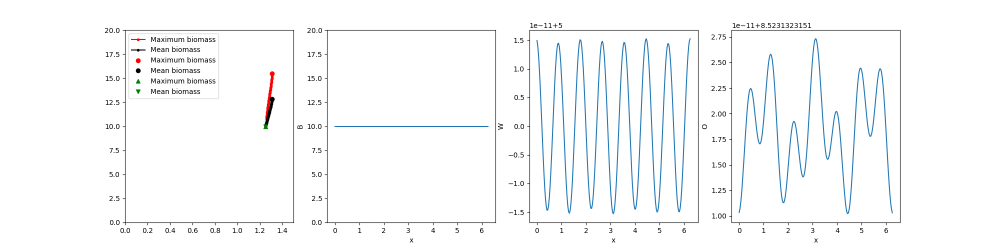

In [329]:
plot_sols(sols6,-1)

In [330]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Fifth mode with low rainfall


In [176]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=5
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0006772760173344


200.00000000441386
0.157079632676023


Text(0, 0.5, 'O')

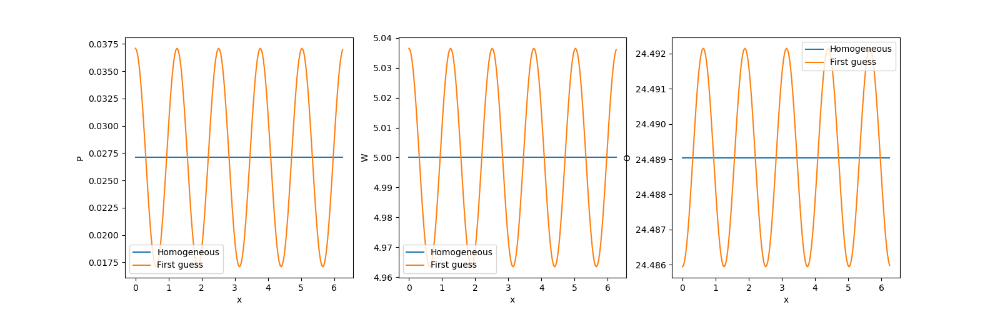

In [177]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [178]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='five'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000441386
9.267414400326857e-07 6.583079303254629e-11


1.0006672760173343


Text(0, 0.5, 'O')

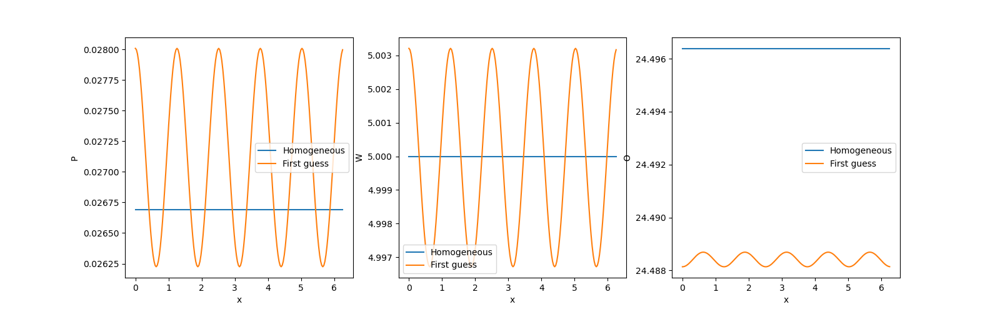

In [179]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [180]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.65:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000000441386


()

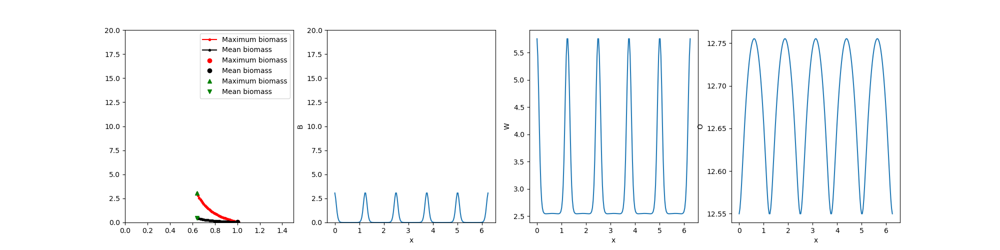

In [181]:
plot_sols(sols,-1)

In [182]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [186]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.640667276017334


In [187]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.594:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000441386


()

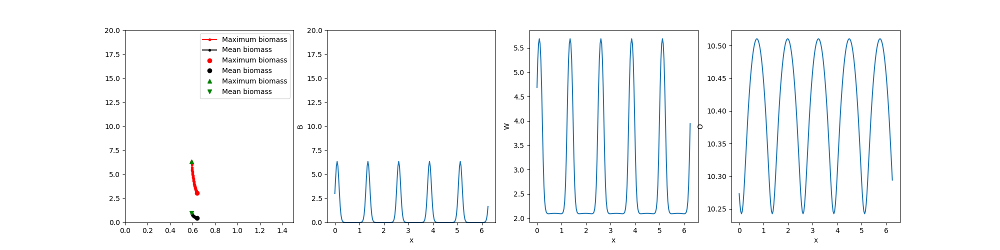

In [188]:
plot_sols(sols2,-1)

In [189]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [190]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.001
Pg = Pg + 2.4
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.5946672760173339


In [191]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.6:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000441386


()

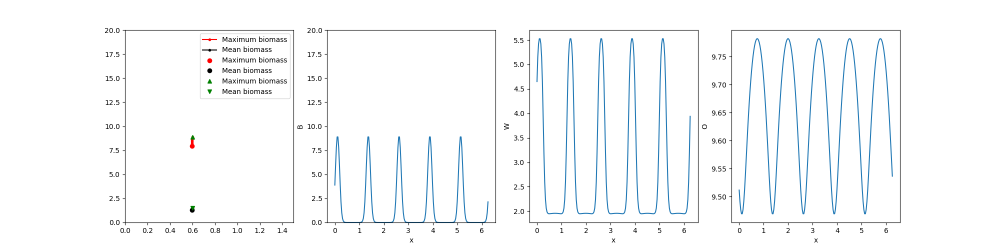

In [192]:
plot_sols(sols3,-1)

In [193]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [219]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.6006672760173339


In [220]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.29:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols4.append([Rain,Pg,Wg,Og])


200.00000000441386


()

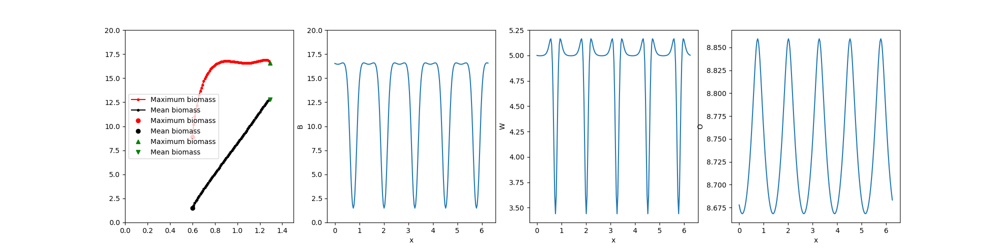

In [222]:
plot_sols(sols4,-1)

In [224]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [231]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.2906672760173346


In [232]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.297:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.00000000441386


()

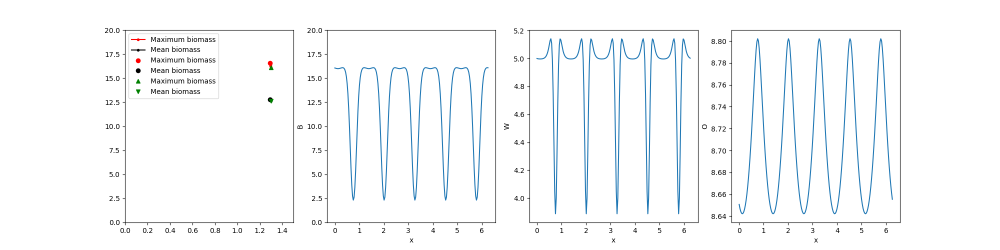

In [233]:
plot_sols(sols5,-1)

In [234]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [273]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.001
Pg = Pg - 3
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.296667276017334


In [274]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.24:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


200.00000000441386


()

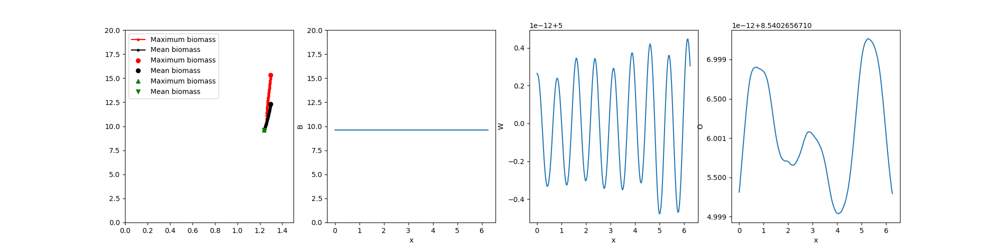

In [275]:
plot_sols(sols6,-1)

In [276]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Sixth mode with low rainfall


In [331]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=6
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.000989866993366


199.99999999972087
0.18849555921565067


Text(0, 0.5, 'O')

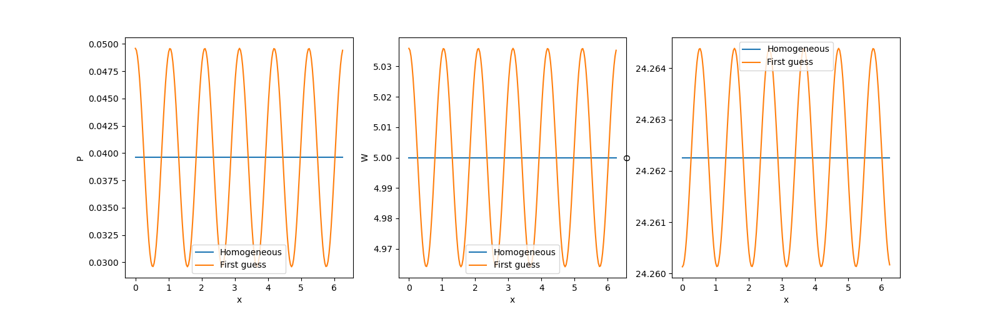

In [332]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [333]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='six'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999972087
9.780790053426358e-07 9.293102348546576e-11


1.0009798669933658


Text(0, 0.5, 'O')

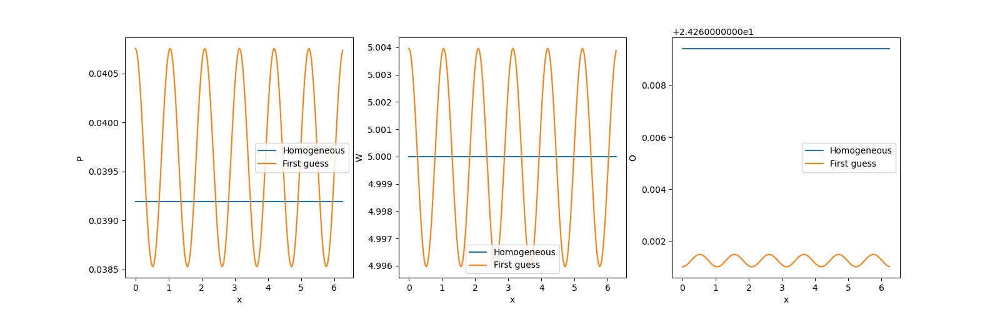

In [334]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [335]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.65:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999999972087


()

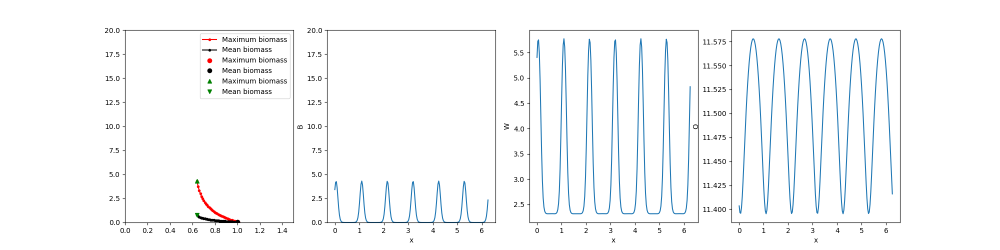

In [336]:
plot_sols(sols,-1)

In [337]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [344]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.6408798669933655


In [345]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.631:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999972087


()

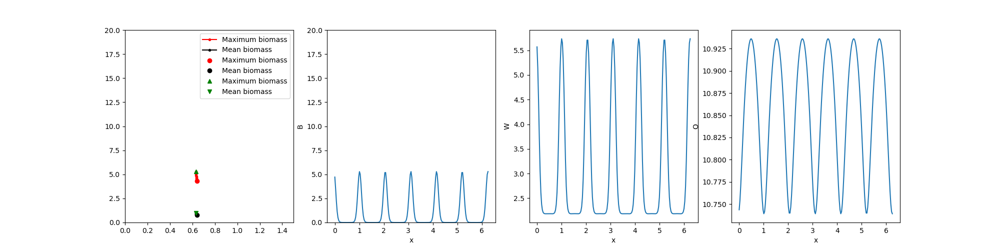

In [346]:
plot_sols(sols2,-1)

In [347]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [348]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 3.25
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.6309798669933655


In [349]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.734:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999972087


()

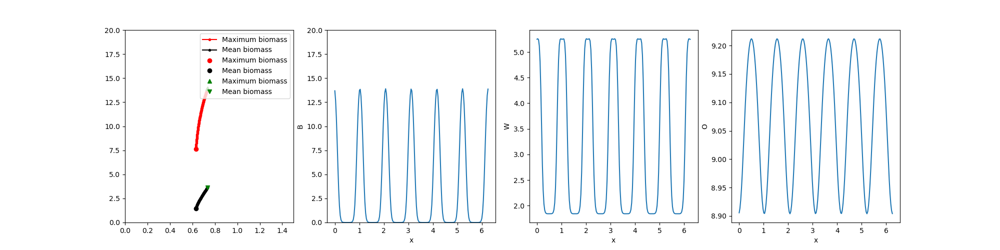

In [350]:
plot_sols(sols3,-1)

In [351]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [352]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


0.7349798669933656


In [353]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.23:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


199.99999999972087


()

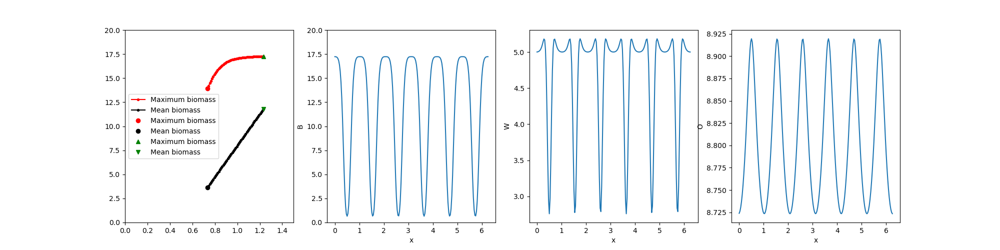

In [354]:
plot_sols(sols4,-1)

In [355]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [356]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.234979866993366


In [357]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.28:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


199.99999999972087


()

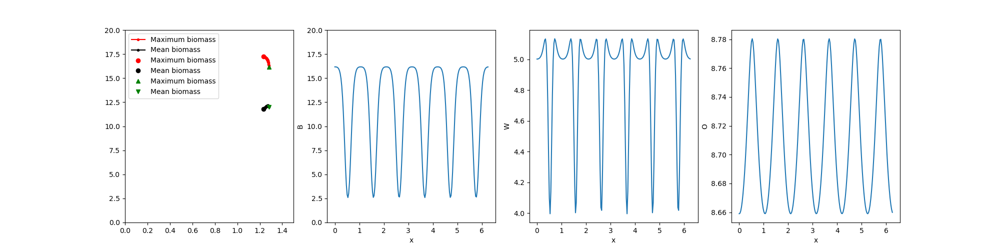

In [358]:
plot_sols(sols5,-1)

In [359]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [360]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0003
Pg = Pg - 3.
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.280679866993361


In [361]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.22:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols6.append([Rain,Pg,Wg,Og])


199.99999999972087


()

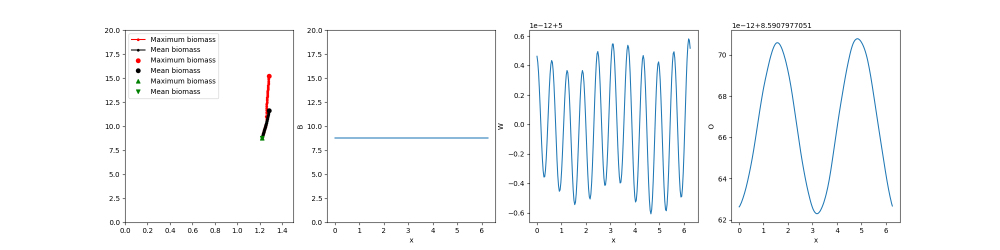

In [362]:
plot_sols(sols6,-1)

In [363]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Seventh mode with low rainfall


In [283]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=7
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0013770002360372


200.00000000274423
0.21991148574826808


Text(0, 0.5, 'O')

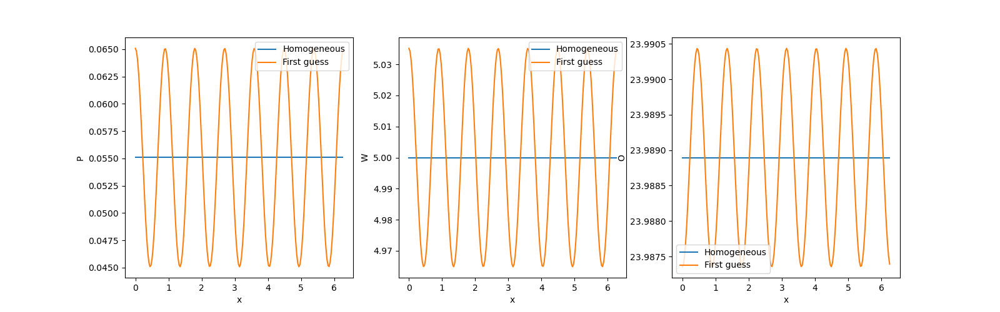

In [284]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [285]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='seven'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000274423
7.934610435356149e-07 9.56334573001444e-11


1.001367000236037


Text(0, 0.5, 'O')

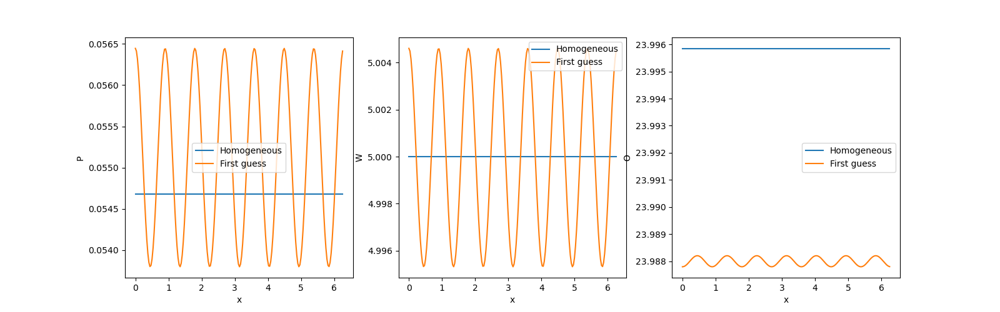

In [286]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [287]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.75:
    Rain = Rain-0.05
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000000274423


()

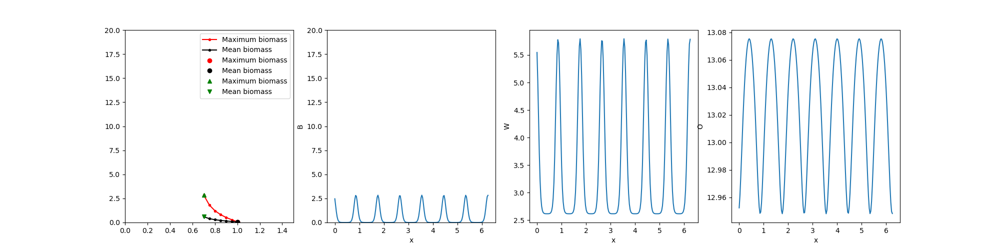

In [288]:
plot_sols(sols,-1)

In [289]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [293]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.7013670002360368


In [294]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.663:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000274423


()

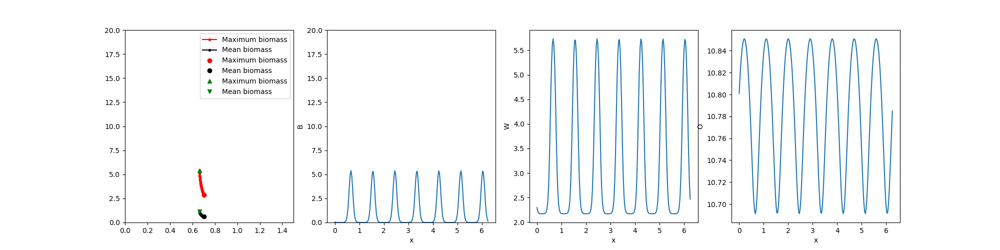

In [295]:
plot_sols(sols2,-1)

In [297]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [316]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.001
Pg = Pg + 2.43
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.6633670002360368


In [317]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.67:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000274423


()

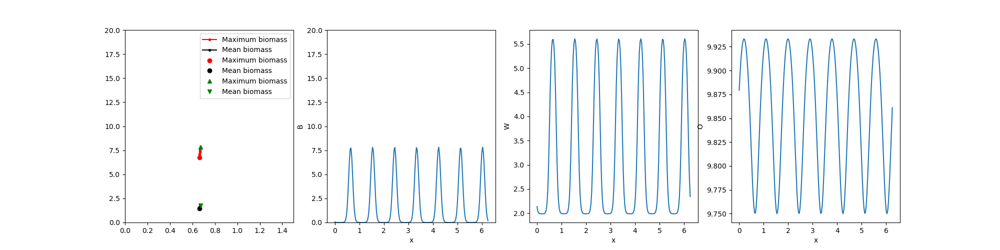

In [318]:
plot_sols(sols3,-1)

In [319]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [333]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.6703670002360368


In [334]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.25:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols4.append([Rain,Pg,Wg,Og])


200.00000000274423


()

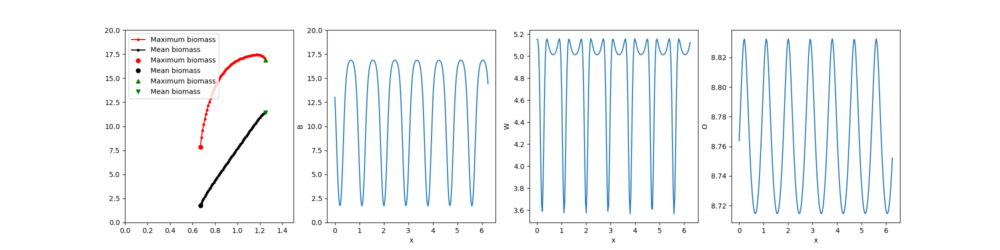

In [335]:
plot_sols(sols4,-1)

In [336]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [351]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.2503670002360372


In [352]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.263:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.00000000274423


()

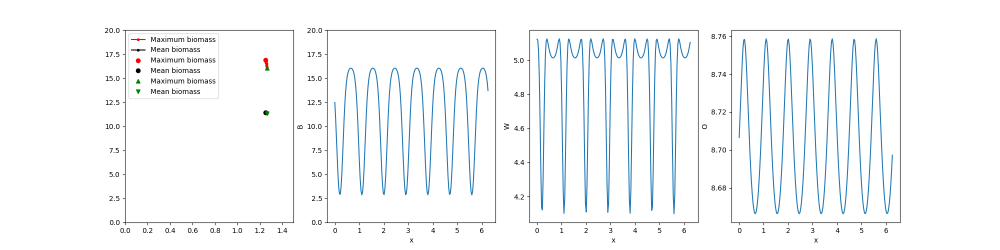

In [353]:
plot_sols(sols5,-1)

In [354]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [361]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0001
Pg = Pg - 2
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.2632670002360358


In [362]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.24:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


200.00000000274423


()

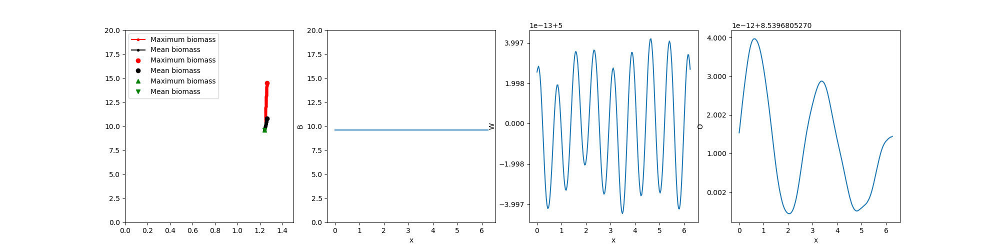

In [363]:
plot_sols(sols6,-1)

In [364]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

In [85]:
Rain,Pg,Wg,Og = sols6[-1]
Rain = Rain + 0.000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols7 = [[Rain,Pnew,Wnew,Onew]]


0.6451358038687015


In [86]:
Rain,Pg,Wg,Og = sols7[0]
while Rain > 0.642:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols7.append([Rain,Pg,Wg,Og])


200.0000000017746


()

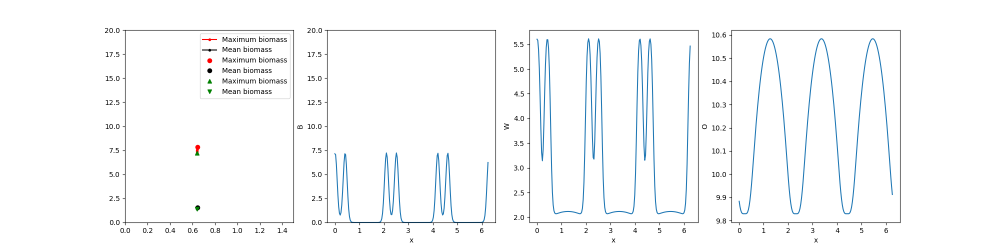

In [87]:
plot_sols(sols7,-1)

In [88]:
save_RvsPWO(sols7,'sols7','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols7,'sols7','O',mode+'R0',int(np.round(L)))

In [108]:
Rain,Pg,Wg,Og = sols7[-1]
Rain = Rain + 0.0001
Pg = Pg - 0.85
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols8 = [[Rain,Pnew,Wnew,Onew]]


0.6412358038687015


In [109]:
Rain,Pg,Wg,Og = sols8[0]
while Rain < 0.68:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols8.append([Rain,Pg,Wg,Og])


200.0000000017746


()

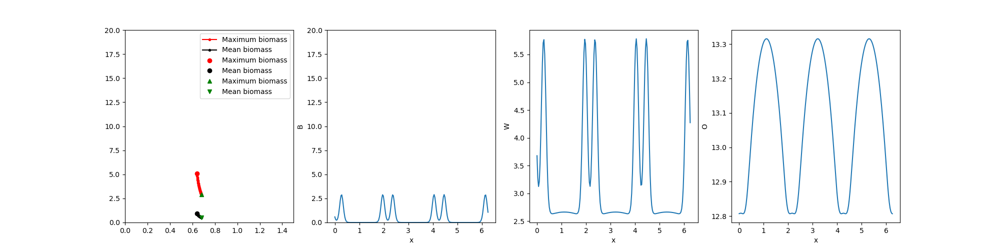

In [110]:
plot_sols(sols8,-1)

In [111]:
save_RvsPWO(sols8,'sols8','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols8,'sols8','O',mode+'R0',int(np.round(L)))

In [122]:
Rain,Pg,Wg,Og = sols8[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols9 = [[Rain,Pnew,Wnew,Onew]]


0.6802358038687015


In [123]:
Rain,Pg,Wg,Og = sols9[0]
while Rain < 0.93:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols9.append([Rain,Pg,Wg,Og])


200.0000000017746


()

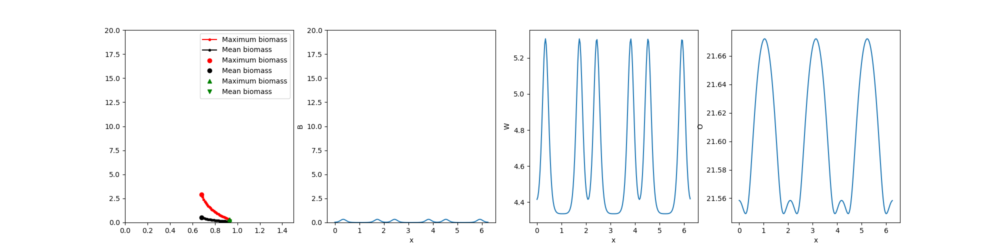

In [133]:
plot_sols(sols9,-1)

In [134]:
save_RvsPWO(sols9,'sols9','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols9,'sols9','O',mode+'R0',int(np.round(L)))

In [143]:
Rain,Pg,Wg,Og = sols9[-1]
Rain = Rain + 0.0000
Pg = Pg - 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols10 = [[Rain,Pnew,Wnew,Onew]]


0.9302358038687017


In [144]:
Rain,Pg,Wg,Og = sols10[0]
while Rain < 1.005:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols10.append([Rain,Pg,Wg,Og])


200.0000000017746


()

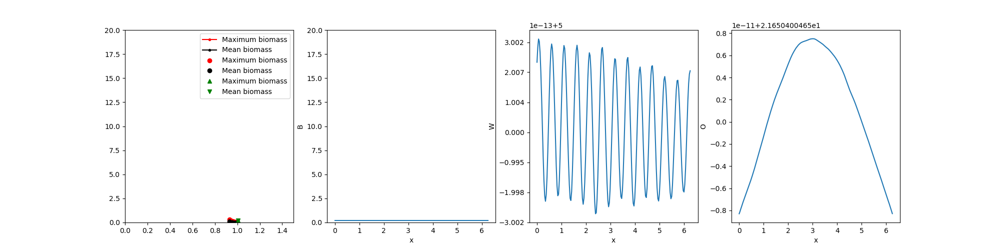

In [145]:
plot_sols(sols10,-1)

In [146]:
save_RvsPWO(sols10,'sols10','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols10,'sols10','O',mode+'R0',int(np.round(L)))

### Eigthth mode with low rainfall


In [365]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=8
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0018482636134887


200.00000000045998
0.25132741228660543


Text(0, 0.5, 'O')

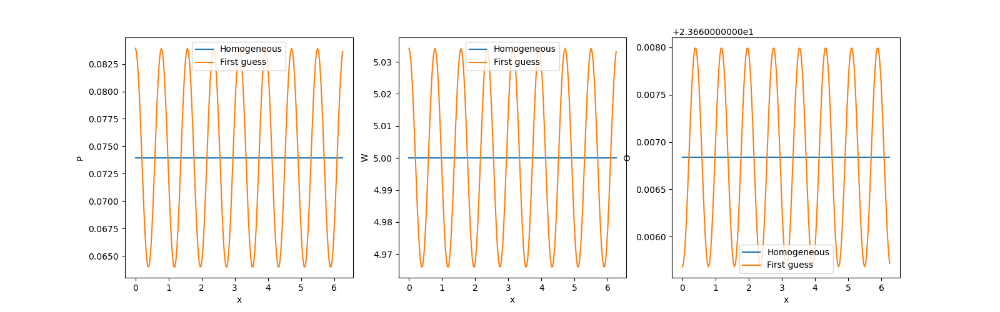

In [366]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [367]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='eight'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000045998
6.454924239562843e-07 9.869350870951756e-11


1.0018382636134886


Text(0, 0.5, 'O')

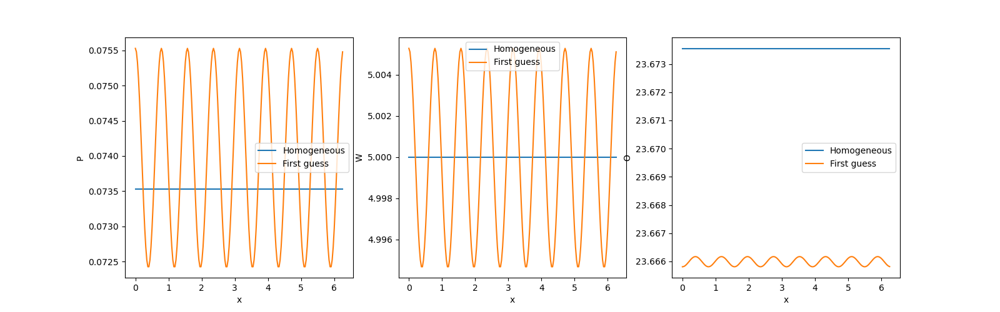

In [369]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [370]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.71:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000000045998


()

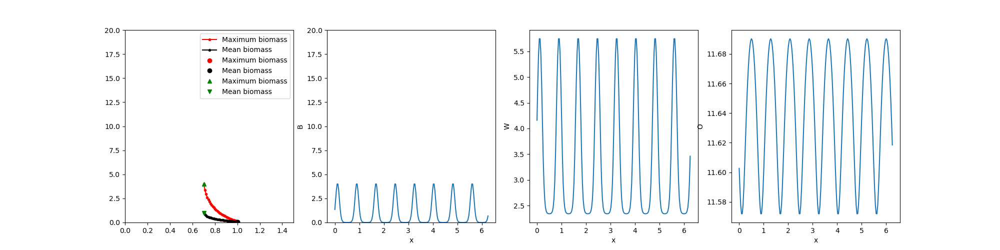

In [371]:
plot_sols(sols,-1)

In [372]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [373]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.7017382636134883


In [374]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.695:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000045998


()

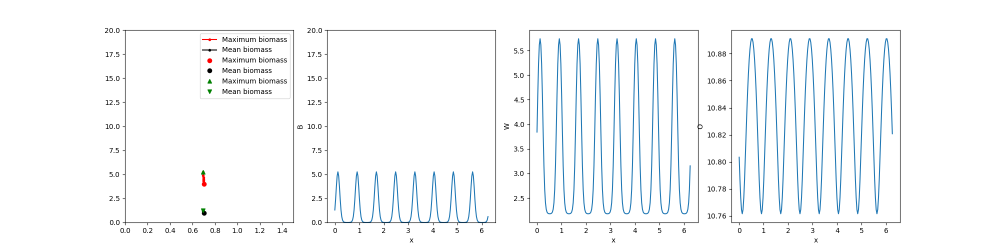

In [375]:
plot_sols(sols2,-1)

In [376]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [377]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 1
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.6948382636134883


In [378]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.93:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000045998


()

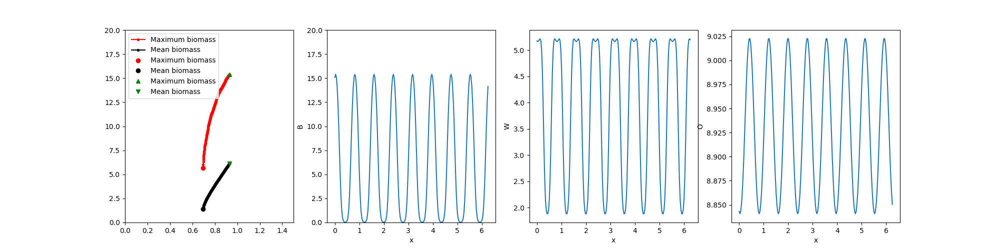

In [379]:
plot_sols(sols3,-1)

In [380]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [381]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


0.9308382636134885


In [382]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.15:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


200.00000000045998


()

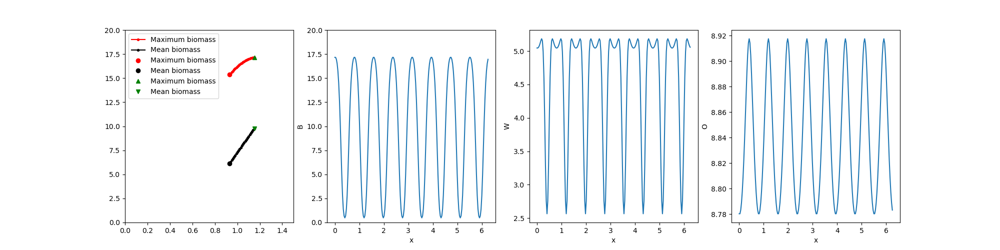

In [383]:
plot_sols(sols4,-1)

In [384]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [385]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.1508382636134886


In [386]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.248:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


200.00000000045998


()

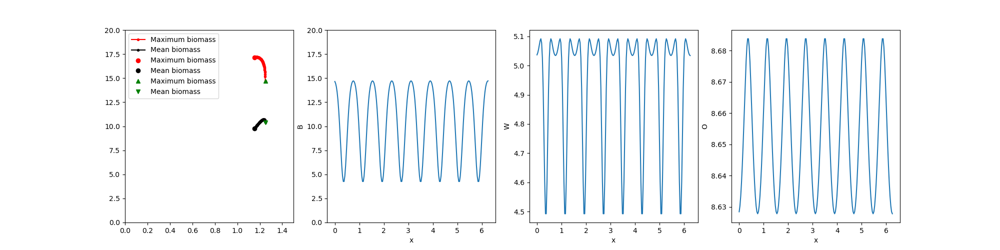

In [387]:
plot_sols(sols5,-1)

In [388]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [389]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0001
Pg = Pg - 1.
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.2487382636134778


In [390]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.22:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols6.append([Rain,Pg,Wg,Og])


200.00000000045998


()

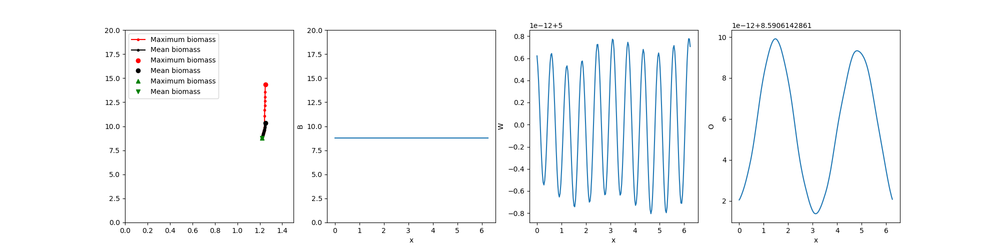

In [391]:
plot_sols(sols6,-1)

In [392]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Nineth mode with low rainfall


In [371]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=9
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0024171181923234


200.0000000022808
0.28274333881985697


Text(0, 0.5, 'O')

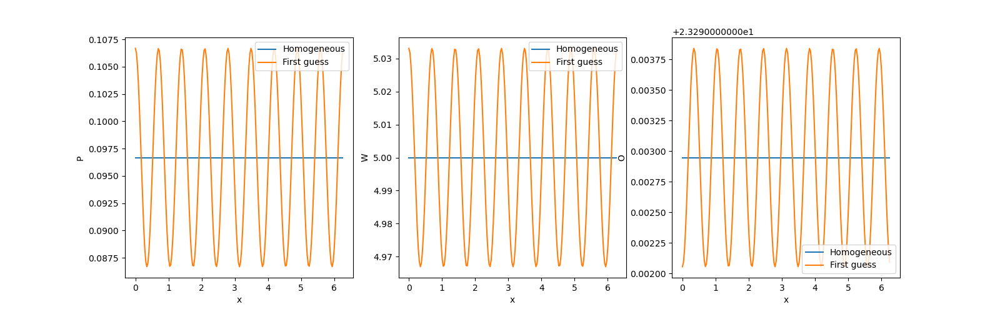

In [372]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [373]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='nine'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.0000000022808
4.66314124203393e-07 9.170815118412357e-11


1.0024071181923233


Text(0, 0.5, 'O')

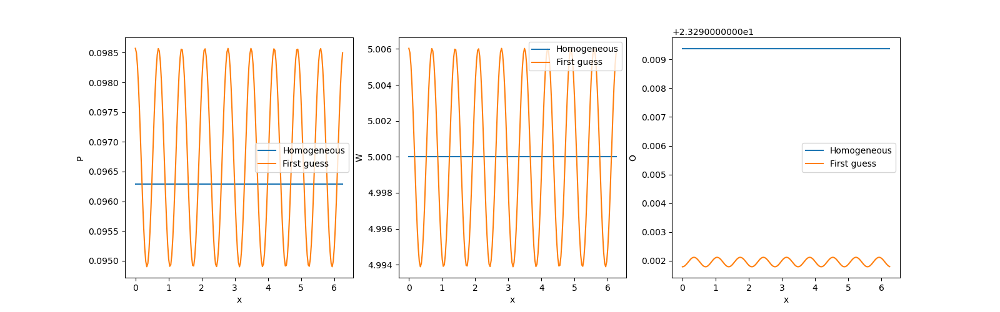

In [374]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [375]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.8:
    Rain = Rain-0.05
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.0000000022808


()

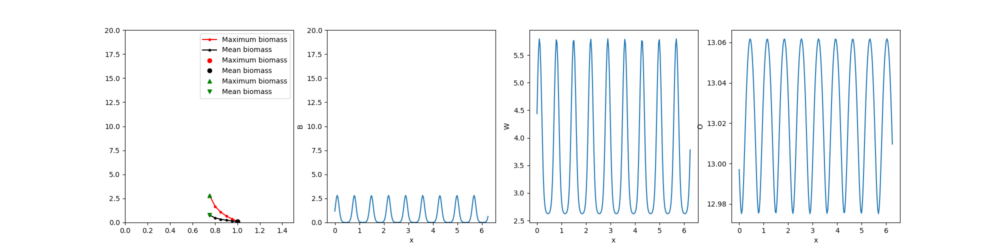

In [376]:
plot_sols(sols,-1)

In [377]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [385]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.7524071181923231


In [386]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.728:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.0000000022808


()

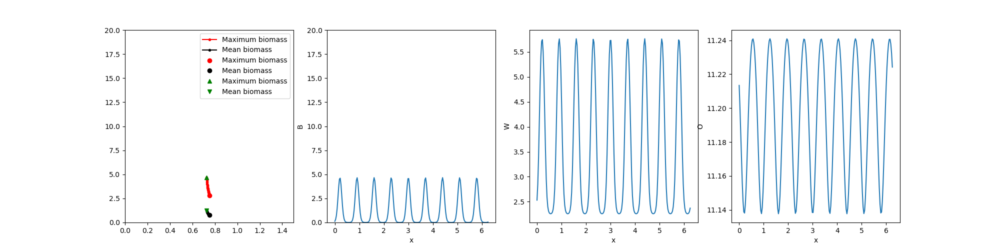

In [387]:
plot_sols(sols2,-1)

In [388]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [398]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 2.1
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.727507118192323


In [399]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.74:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.0000000022808


()

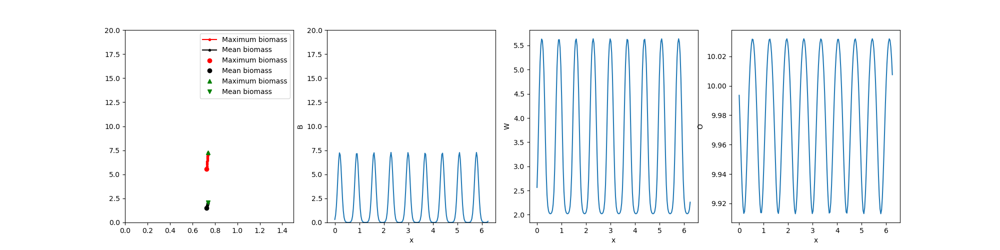

In [400]:
plot_sols(sols3,-1)

In [401]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [414]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.7405071181923231


In [415]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.22:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-11)
    sols4.append([Rain,Pg,Wg,Og])


200.0000000022808


()

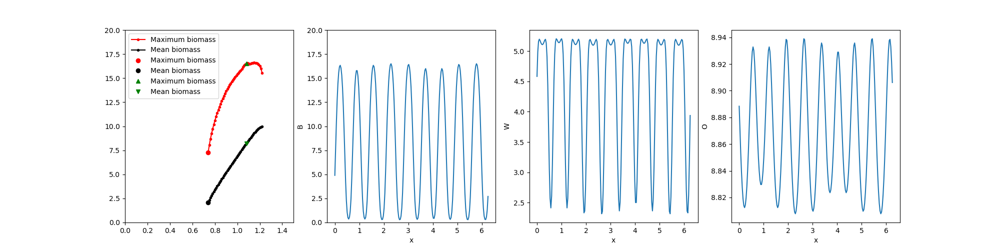

In [416]:
plot_sols(sols4,-15)

In [417]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [423]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.2205071181923235


In [424]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.232:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.0000000022808


()

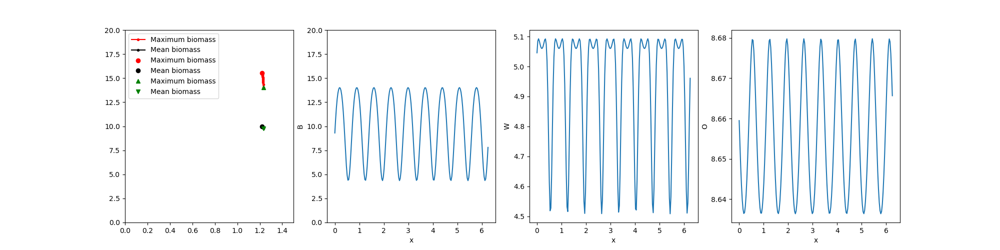

In [425]:
plot_sols(sols5,-1)

In [426]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [432]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.001
Pg = Pg - 1.5
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.2315071181923223


In [433]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.22:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


200.0000000022808


()

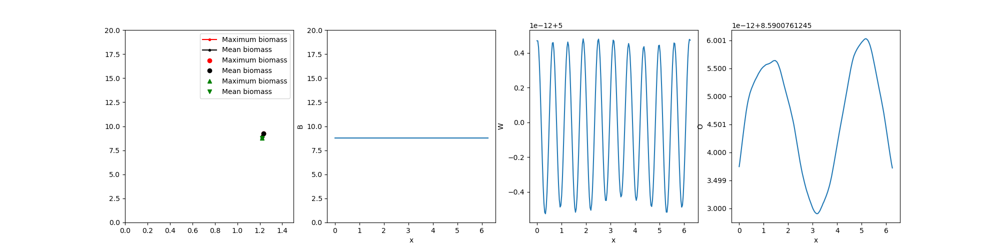

In [434]:
plot_sols(sols6,-1)

In [435]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Tenth mode with low rainfall


In [393]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=10
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0031021209537154


199.9999999999209
0.31415926535910355


Text(0, 0.5, 'O')

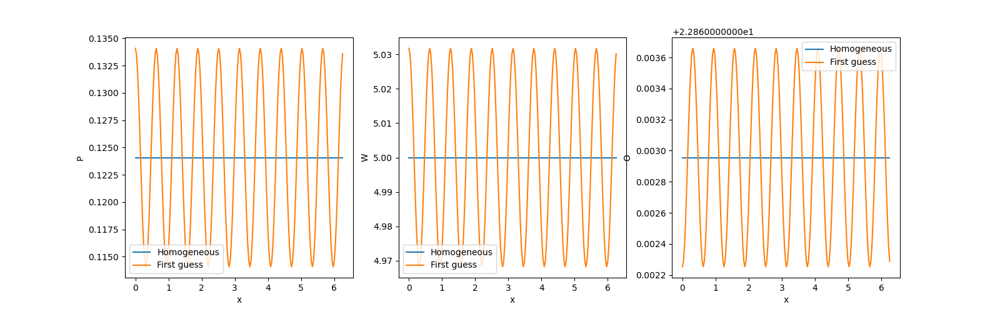

In [394]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [395]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='ten'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.9999999999209
3.725229023032739e-07 9.497168560780211e-11


1.0030921209537154


Text(0, 0.5, 'O')

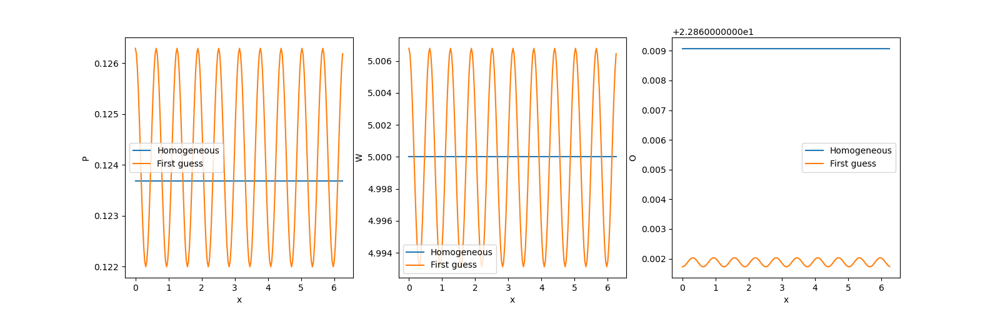

In [397]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [398]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.77:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.9999999999209


()

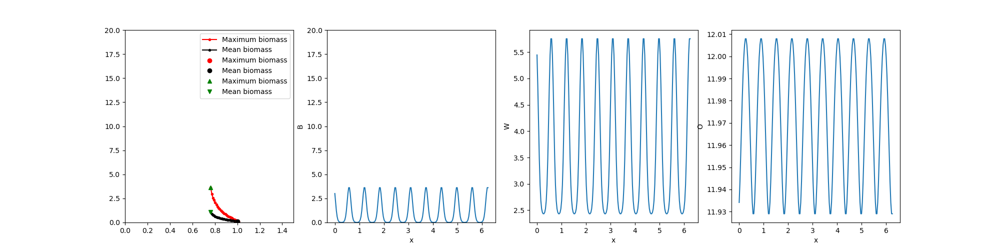

In [399]:
plot_sols(sols,-1)

In [400]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [401]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.7629921209537152


In [402]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.759:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


199.9999999999209


()

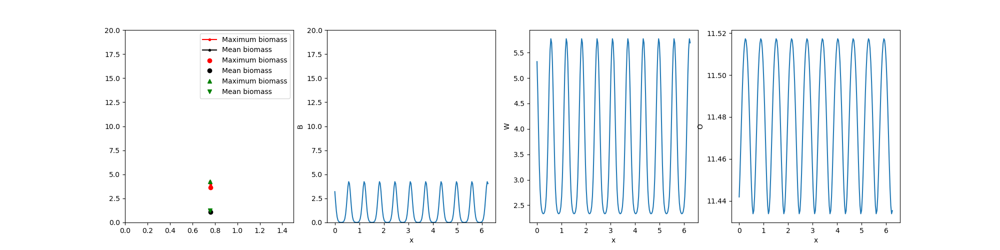

In [403]:
plot_sols(sols2,-1)

In [404]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [409]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 4.5
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.7590921209537151


In [410]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.77:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


199.9999999999209


()

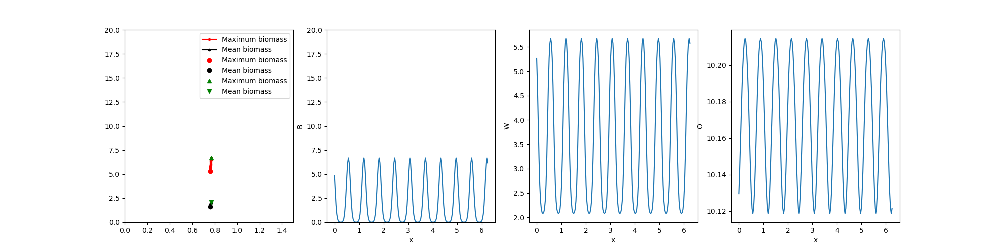

In [411]:
plot_sols(sols3,-1)

In [412]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [413]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


0.7700921209537152


In [414]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.20:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


199.9999999999209


()

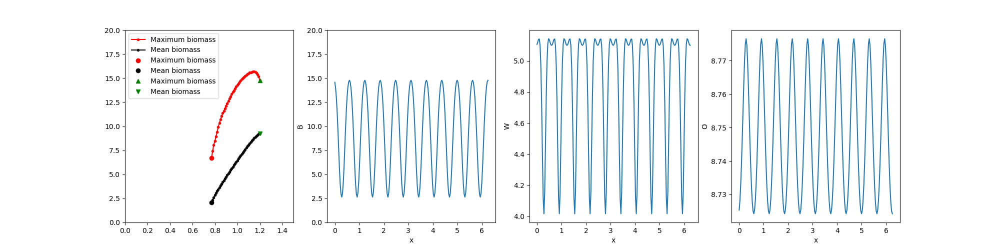

In [415]:
plot_sols(sols4,-1)

In [416]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [417]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.2000921209537154


In [418]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.22:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


199.9999999999209


()

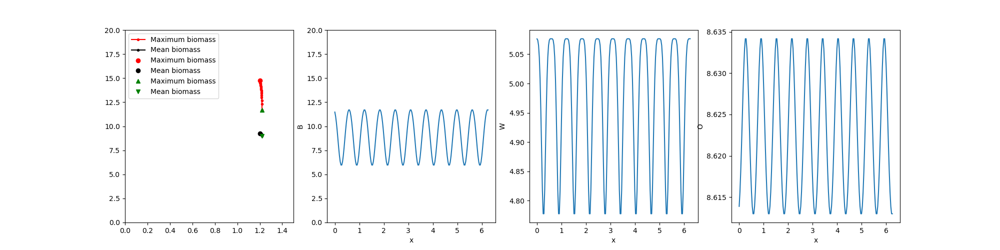

In [419]:
plot_sols(sols5,-1)

In [420]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [421]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0.0001
Pg = Pg - 1.
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.2199921209537132


In [422]:
Rain,Pg,Wg,Og = sols6[0]
while Rain > 1.21:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols6.append([Rain,Pg,Wg,Og])


199.9999999999209


()

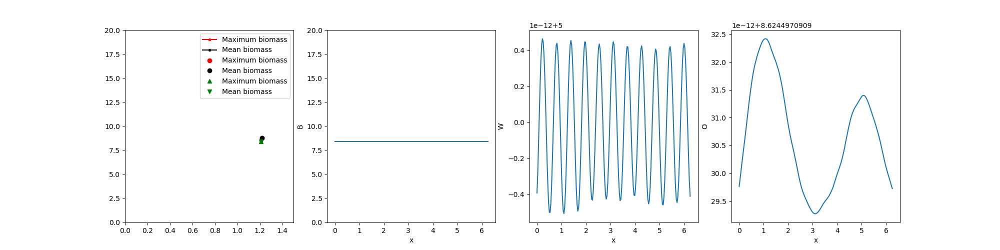

In [423]:
plot_sols(sols6,-1)

In [424]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Eleventh mode with low rainfall


In [441]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=11
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0039282855881155


200.00000000299246
0.3455751918897066


Text(0, 0.5, 'O')

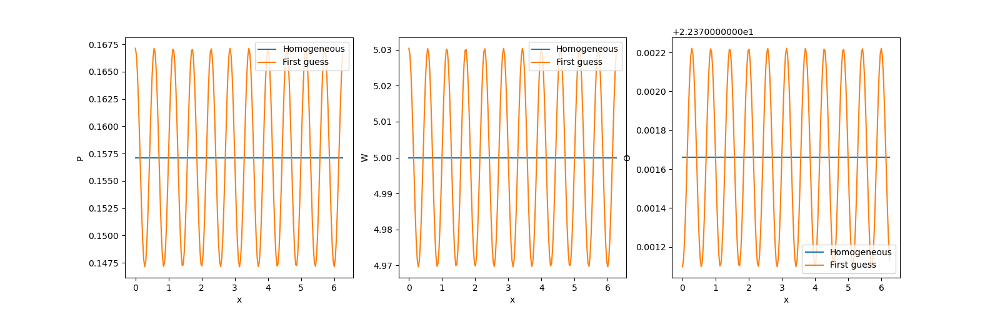

In [442]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [443]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='eleven'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000299246
3.068099347913744e-07 9.827206992091518e-11


1.0039182855881155


Text(0, 0.5, 'O')

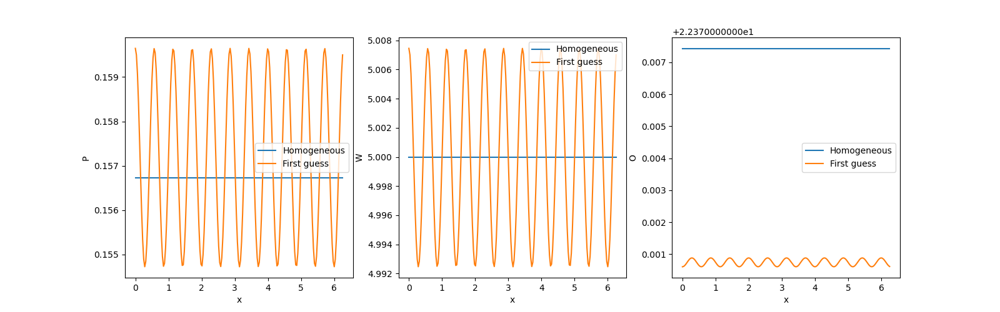

In [444]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [445]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.85:
    Rain = Rain-0.05
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000000299246


()

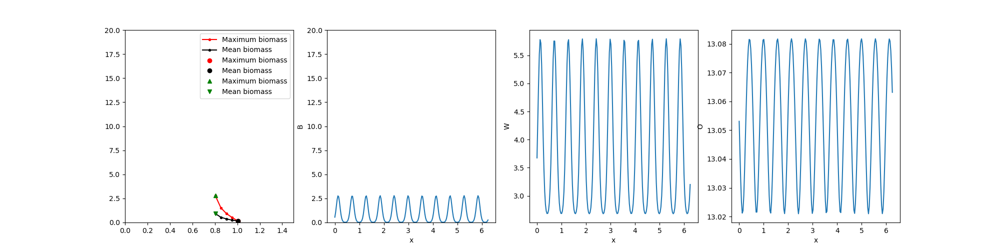

In [446]:
plot_sols(sols,-1)

In [448]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [451]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.8039182855881153


In [452]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.789:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000299246


()

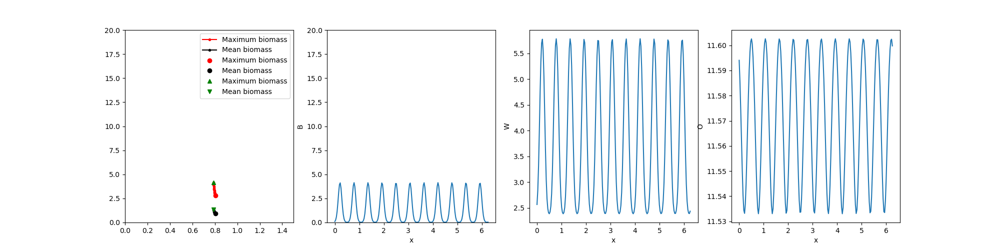

In [453]:
plot_sols(sols2,-1)

In [454]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [483]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.001
Pg = Pg + 1.53
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.7899182855881153


In [484]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.799:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000299246


()

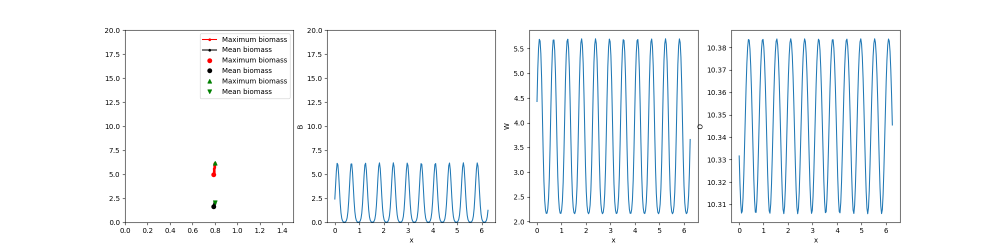

In [486]:
plot_sols(sols3,-1)

In [487]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [491]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.7999182855881153


In [492]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.18:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-11)
    sols4.append([Rain,Pg,Wg,Og])


200.00000000299246


()

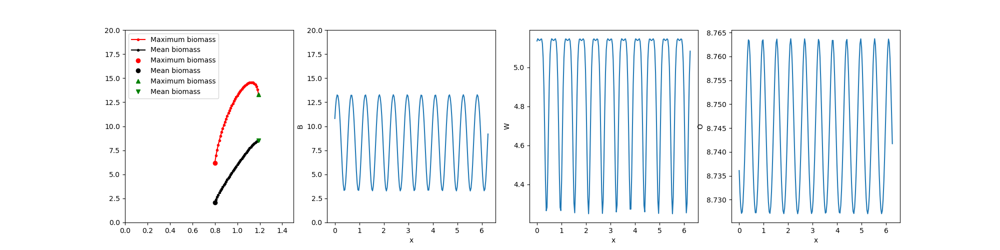

In [494]:
plot_sols(sols4,-1)

In [495]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [506]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.1899182855881156


In [507]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.206:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.00000000299246


()

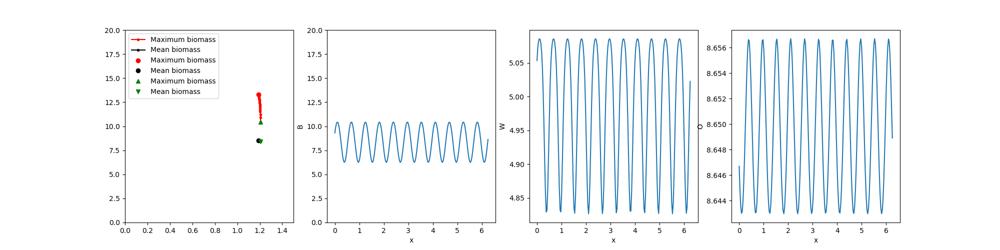

In [508]:
plot_sols(sols5,-1)

In [509]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [551]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.2069182855881138


In [552]:
Rain,Pg,Wg,Og = sols6[0]
while Rain < 1.2085:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


200.00000000299246


()

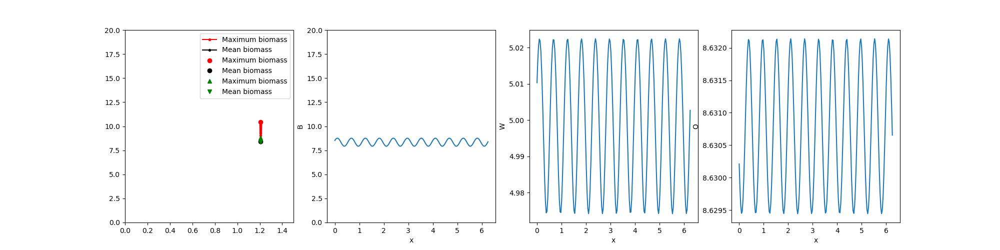

In [553]:
plot_sols(sols6,-1)

In [555]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Twelfth mode with low rainfall


In [425]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=12
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0049293044733156


199.99999999937393
0.3769911184319553


Text(0, 0.5, 'O')

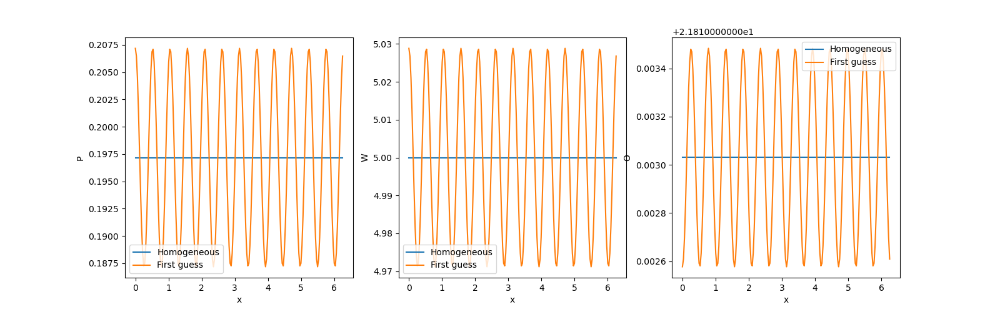

In [426]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [427]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='twelve'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999937393
2.1667018668125593e-07 9.175824786180715e-11


1.0049193044733156


Text(0, 0.5, 'O')

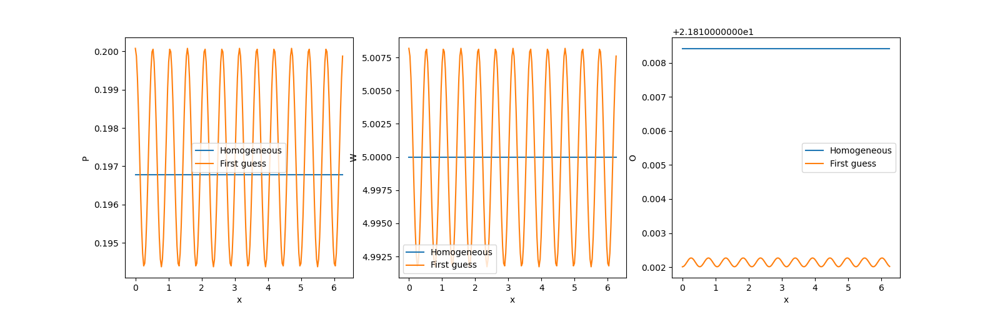

In [428]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [429]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.83:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999999937393


()

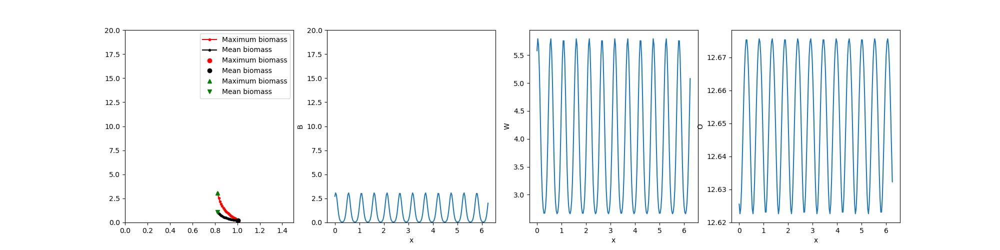

In [430]:
plot_sols(sols,-1)

In [431]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [432]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.8248193044733154


In [433]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.8185:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999937393


()

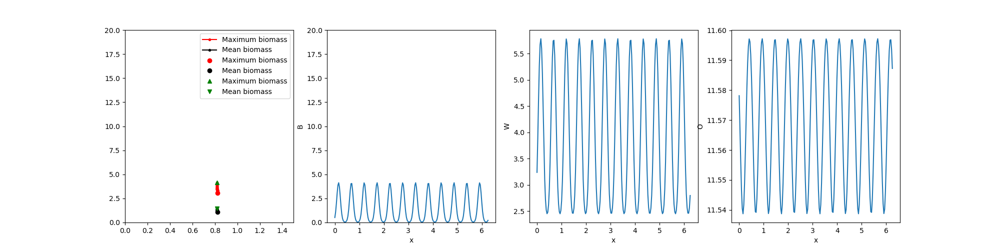

In [445]:
plot_sols(sols2,-1)

In [446]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [456]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 0.95
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.8185193044733161


In [457]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 1.18:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999937393


()

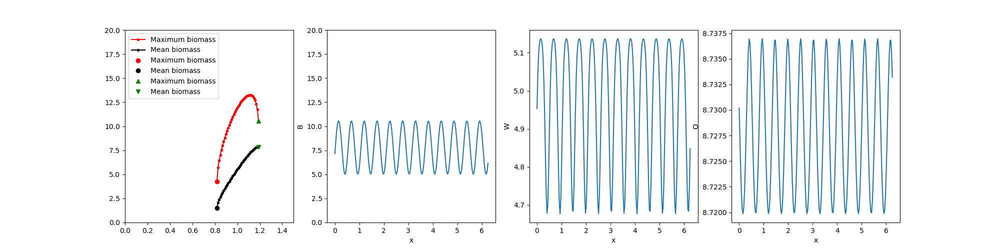

In [458]:
plot_sols(sols3,-1)

In [459]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [460]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


1.1885193044733164


In [461]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.1948:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


1.1948193044733157
199.99999999937393


()

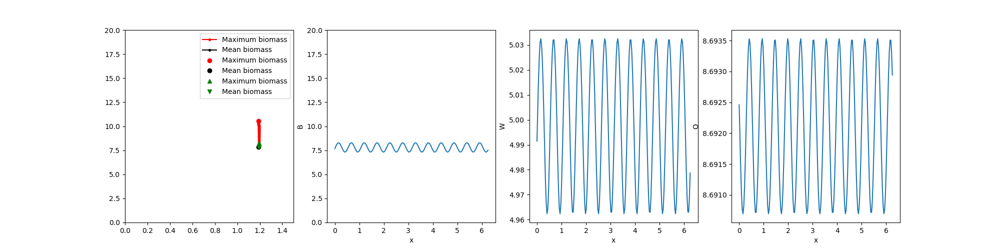

In [468]:
print(sols4[-1][0])
plot_sols(sols4,-1)

In [469]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [486]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.1948193044733157


In [487]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.1981:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


1.1978193044733154
1.1988193044733153
199.99999999937393


()

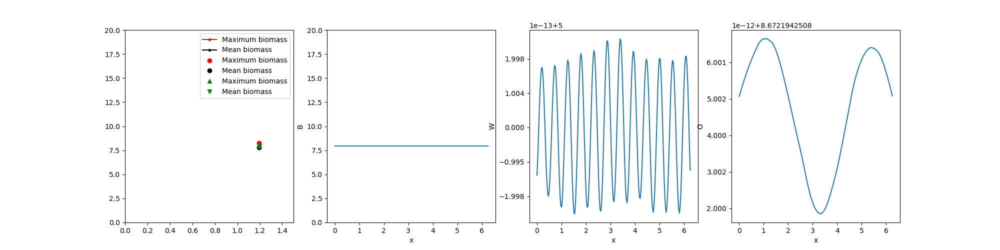

In [488]:
print(sols5[-2][0])
print(sols5[-1][0])
plot_sols(sols5,-1)

In [489]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

### Thirteenth mode with low rainfall


In [561]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=13
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0061545254200164


199.99999998823648
0.40840704499069463


Text(0, 0.5, 'O')

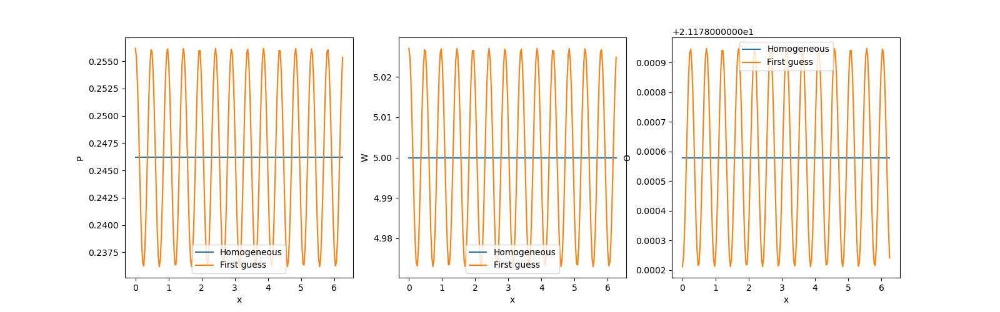

In [562]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [563]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='thirteen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999998823648
1.8319436190239458e-07 9.491406130742515e-11


1.0061445254200163


Text(0, 0.5, 'O')

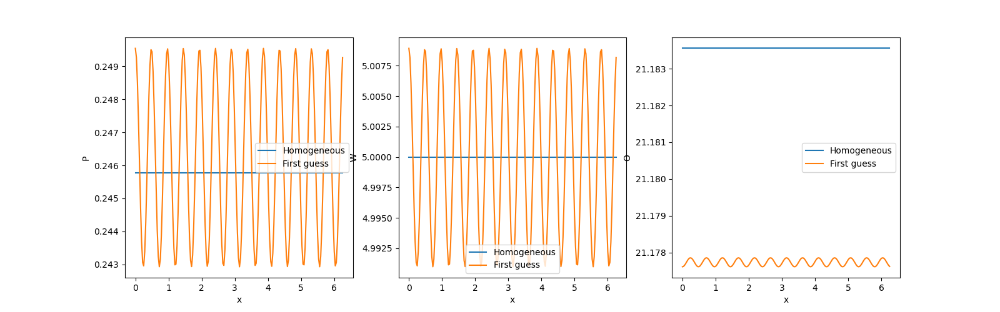

In [564]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [565]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.90:
    Rain = Rain-0.05
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999998823648


()

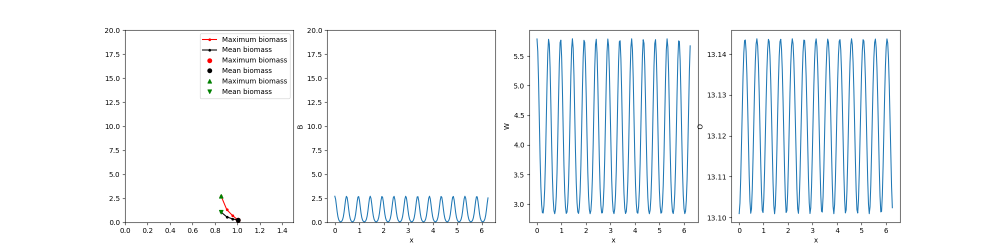

In [566]:
plot_sols(sols,-1)

In [567]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [570]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.8561445254200162


In [571]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.849:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


199.99999998823648


()

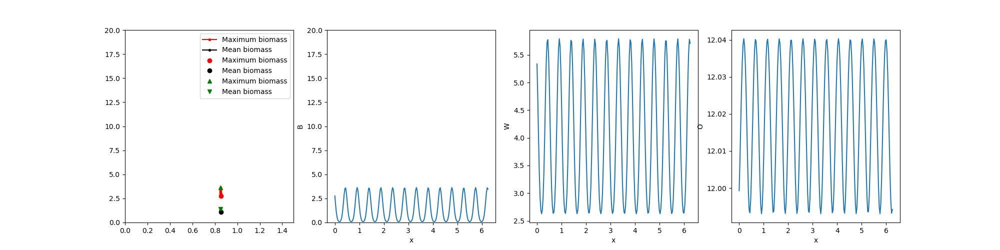

In [572]:
plot_sols(sols2,-1)

In [573]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [583]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 1.8
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.8482445254200162


In [584]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.85:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


199.99999998823648


()

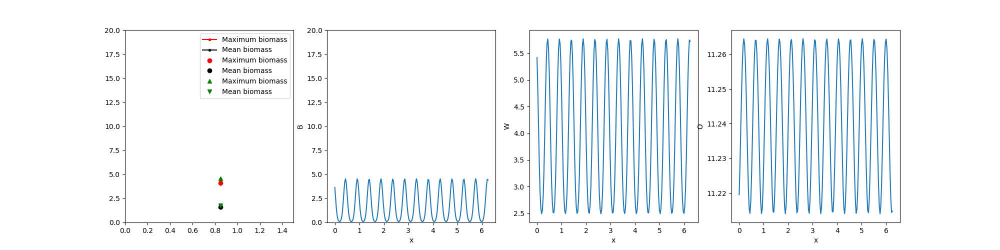

In [585]:
plot_sols(sols3,-1)

In [586]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [588]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.8502445254200162


In [589]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.15:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-11)
    sols4.append([Rain,Pg,Wg,Og])


199.99999998823648


()

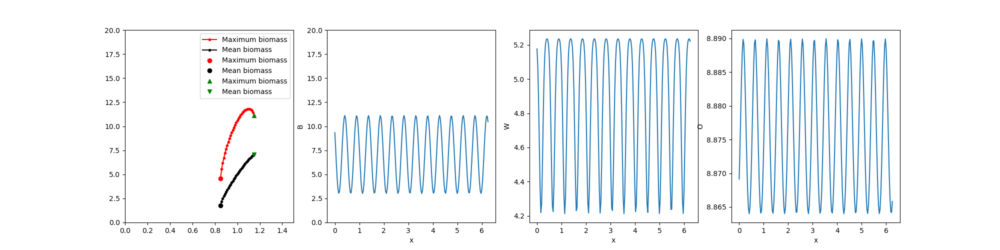

In [590]:
plot_sols(sols4,-1)

In [591]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [607]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.1502445254200164


In [608]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.18:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


199.99999998823648


()

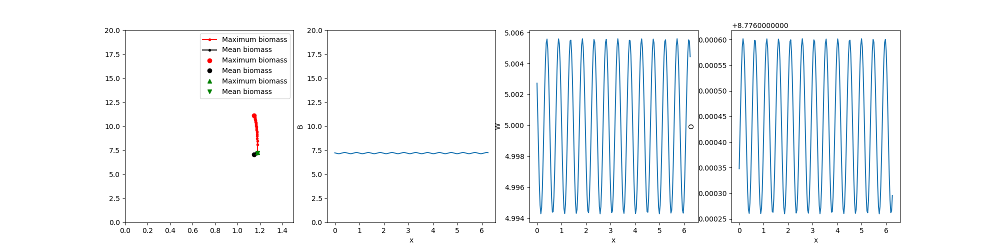

In [609]:
plot_sols(sols5,-1)

In [610]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

In [611]:
Rain,Pg,Wg,Og = sols5[-1]
Rain = Rain - 0
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols6 = [[Rain,Pnew,Wnew,Onew]]


1.1802445254200131


In [612]:
Rain,Pg,Wg,Og = sols6[0]
while Rain < 1.181:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols6.append([Rain,Pg,Wg,Og])


199.99999998823648


()

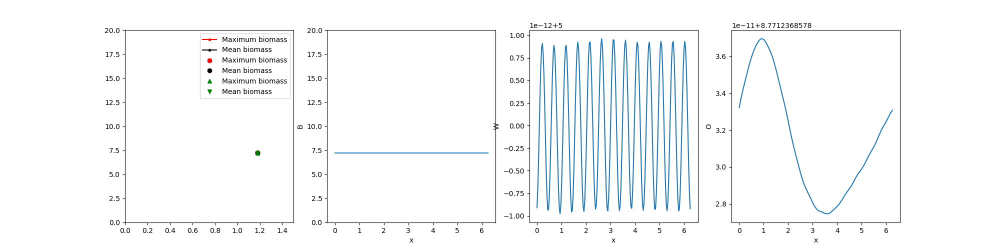

In [613]:
plot_sols(sols6,-1)

In [614]:
save_RvsPWO(sols6,'sols6','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols6,'sols6','O',mode+'R0',int(np.round(L)))

### Fourteenth mode with low rainfall


In [502]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=14
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0076772871957622


200.0000000009474
0.43982297150048755


Text(0, 0.5, 'O')

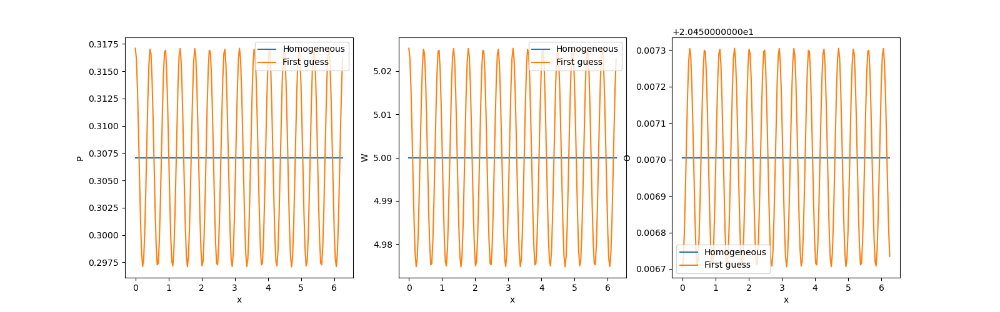

In [503]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [504]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='fourteen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.0000000009474
1.30679421062041e-07 9.873932362497376e-11


1.0076672871957622


Text(0, 0.5, 'O')

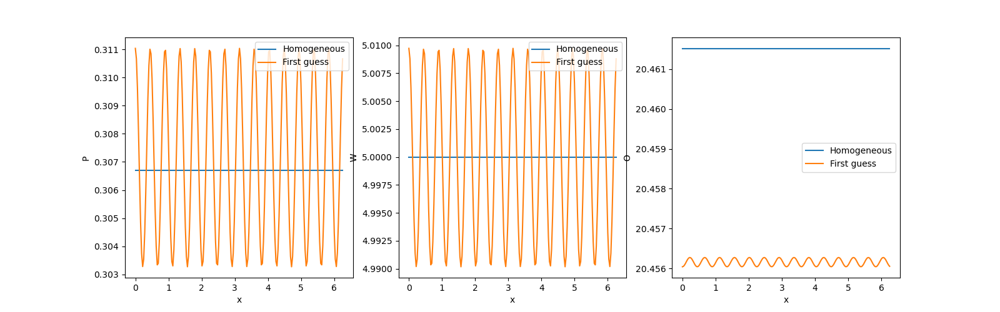

In [505]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [506]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.88:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


fourteen
200.0000000009474


()

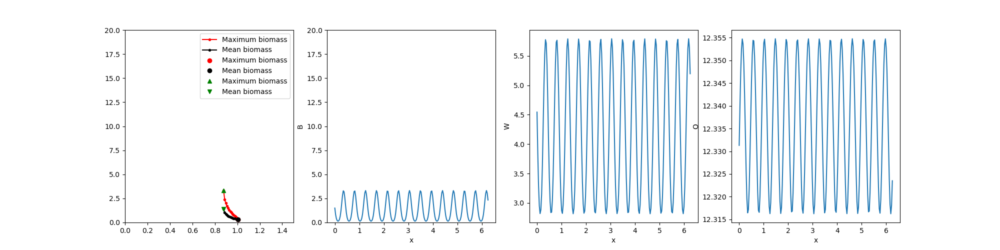

In [527]:
print(mode)
plot_sols(sols,-1)

In [509]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [528]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.877567287195762


In [529]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.8772:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


200.0000000009474


()

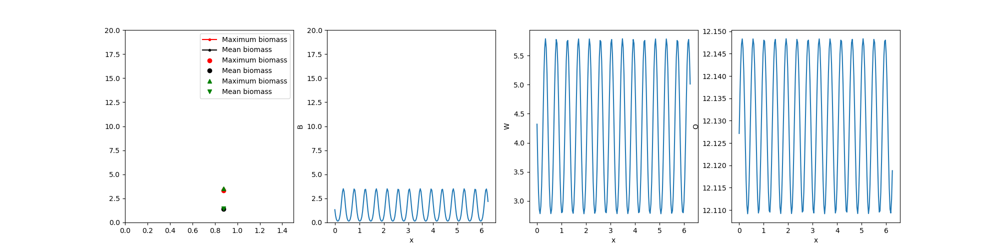

In [530]:
plot_sols(sols2,-1)

In [531]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [532]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 0.6
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.8772672871957621


In [533]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 1.14:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


200.0000000009474


()

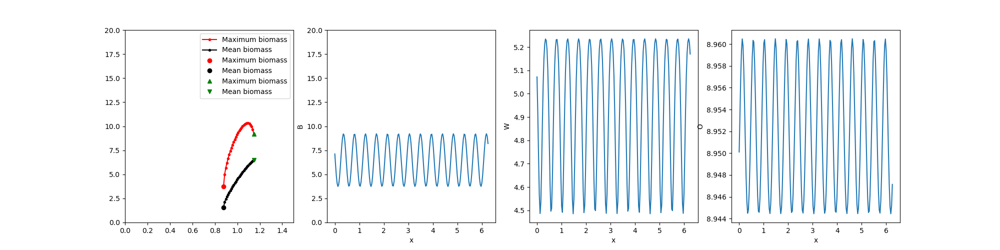

In [534]:
plot_sols(sols3,-1)

In [535]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [536]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


1.1472672871957623


In [537]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.1643:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


1.1643672871957604
200.0000000009474


()

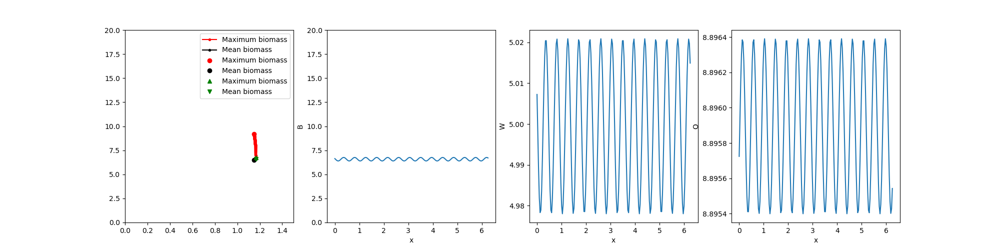

In [538]:
print(sols4[-1][0])
plot_sols(sols4,-1)

In [539]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [540]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols5 = [[Rain,Pg,Wg,Og]]


1.1643672871957604


In [541]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.165:
    Rain = Rain+0.00001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols5.append([Rain,Pg,Wg,Og])


1.1649972871957646
1.1650072871957646
200.0000000009474


()

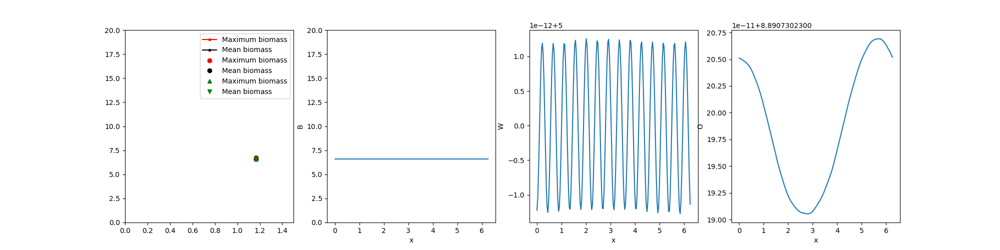

In [542]:
print(sols5[-2][0])
print(sols5[-1][0])
plot_sols(sols5,-1)

In [543]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

### Fifteenth mode with low rainfall


In [634]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=15
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.009614387757079


200.00000001330912
0.47123889800711005


Text(0, 0.5, 'O')

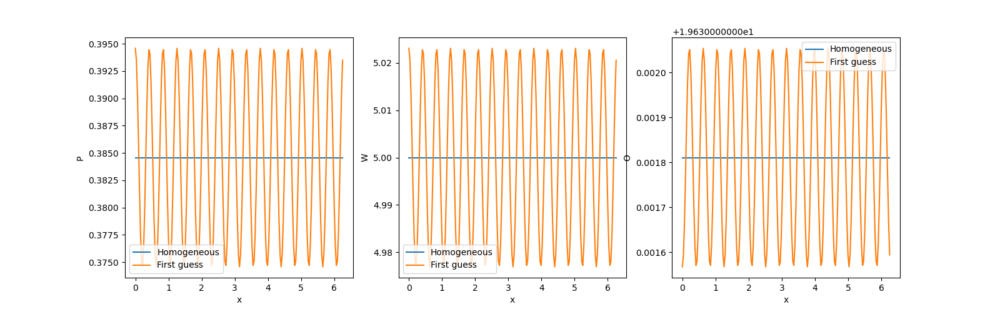

In [635]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [636]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='fifteen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000001330912
1.0589565935248402e-07 9.232982581945605e-11


1.0096043877570788


Text(0, 0.5, 'O')

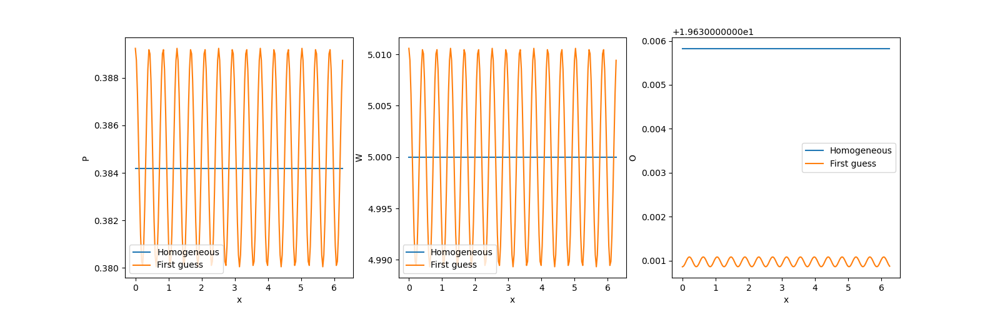

In [637]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [638]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.98:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


200.00000001330912


()

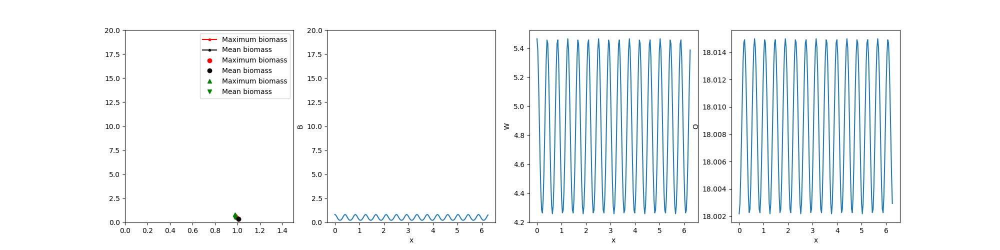

In [639]:
plot_sols(sols,-1)

In [640]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [647]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.9796043877570788


In [648]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.907:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


200.00000001330912


()

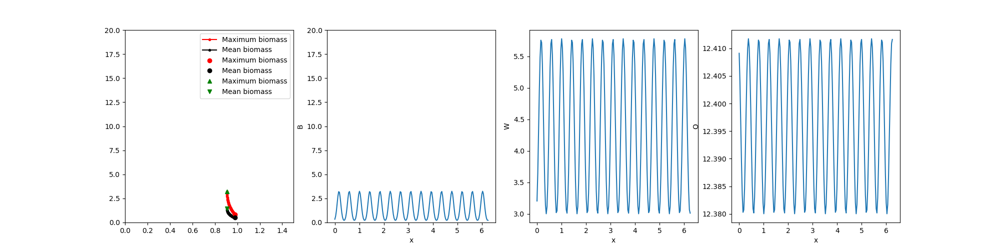

In [649]:
plot_sols(sols2,-1)

In [650]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [707]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 12
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.9067043877570787


In [708]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.95:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


200.00000001330912


()

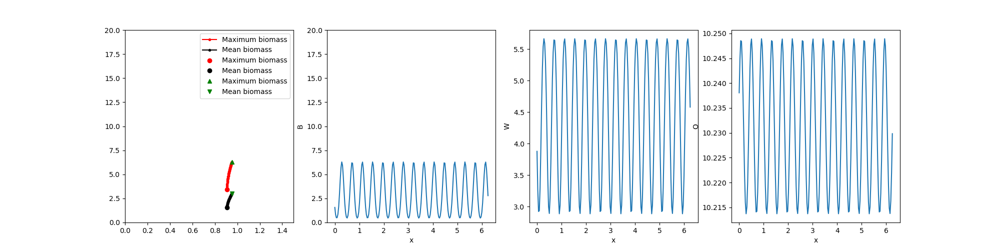

In [709]:
plot_sols(sols3,-1)

In [714]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [715]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.9507043877570788


In [716]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.14:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-11)
    sols4.append([Rain,Pg,Wg,Og])


200.00000001330912


()

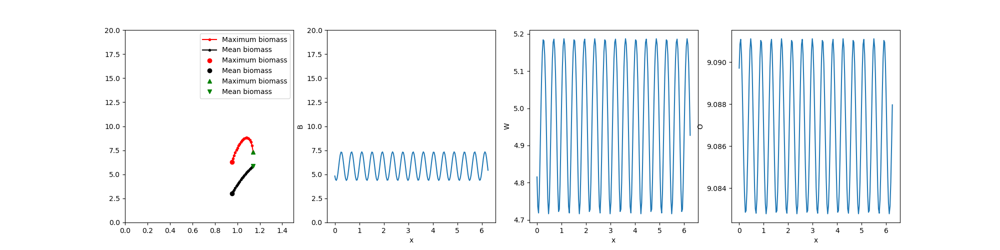

In [717]:
plot_sols(sols4,-1)

In [718]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [722]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.1407043877570788


In [723]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.152:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


200.00000001330912


()

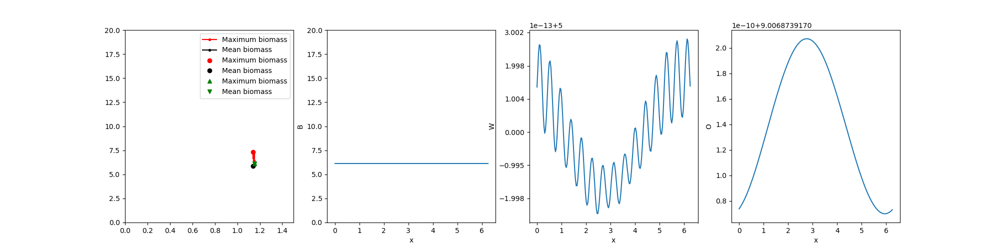

In [724]:
plot_sols(sols5,-1)

In [725]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

### Sixteenth mode with low rainfall


In [548]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=16
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0121679551685077


200.00000000005892
0.5026548245742188


Text(0, 0.5, 'O')

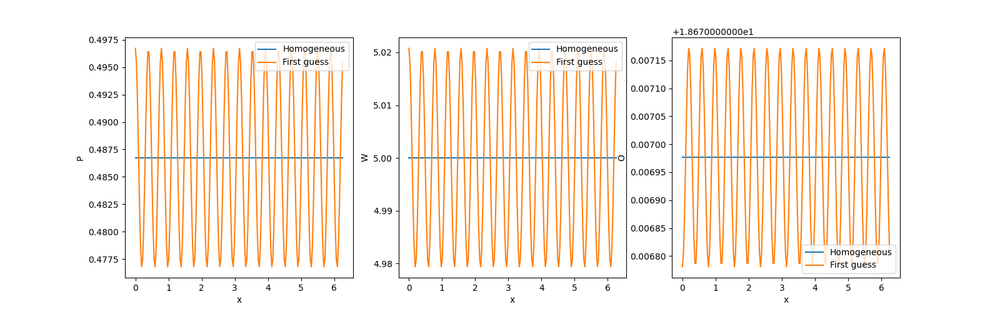

In [549]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [550]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='sixteen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

200.00000000005892
3.3650248187910847e-07 9.569895410828102e-11


1.0121579551685076


Text(0, 0.5, 'O')

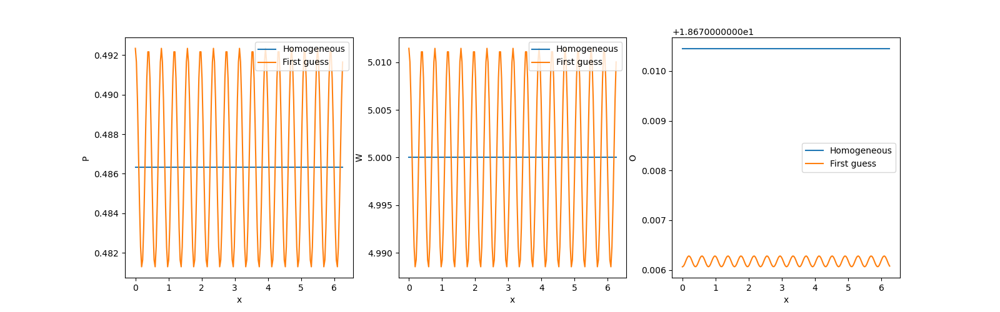

In [551]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [552]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.95:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


sixteen
200.00000000005892


()

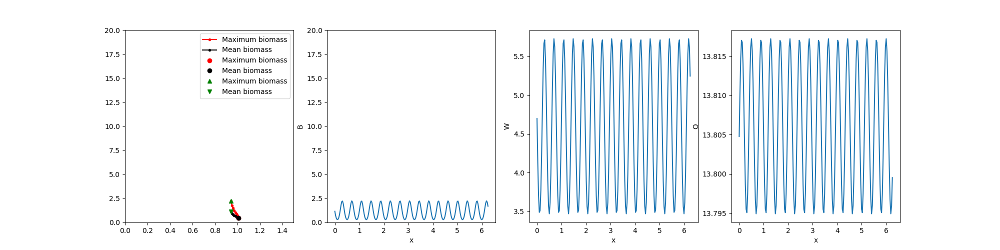

In [553]:
print(mode)
plot_sols(sols,-1)

In [554]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [558]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pg,Wg,Og]]


0.9420579551685075


In [559]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.9367:
    Rain = Rain-0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


200.00000000005892


()

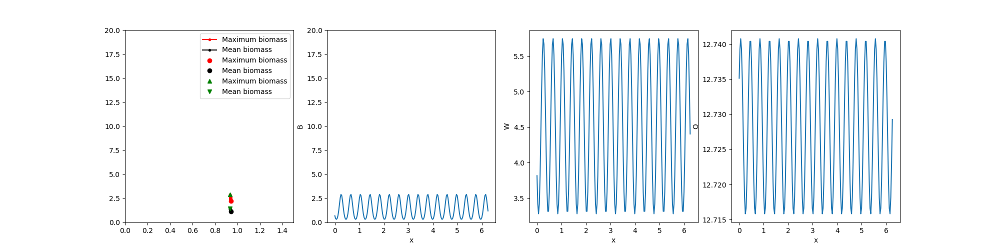

In [560]:
plot_sols(sols2,-1)

In [561]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [577]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 2.8
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.9367579551685081


In [578]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 1.11:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols3.append([Rain,Pg,Wg,Og])


200.00000000005892


()

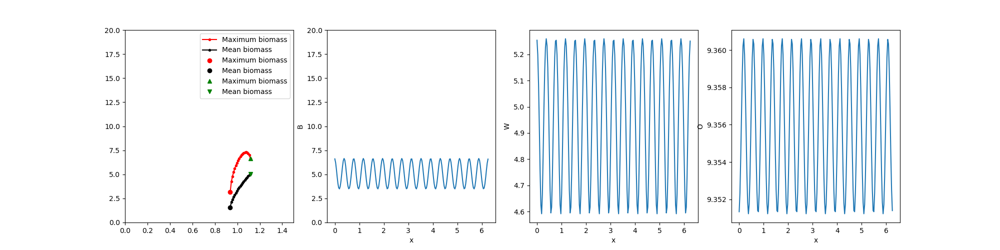

In [579]:
plot_sols(sols3,-1)

In [580]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [581]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.000
Pg = Pg + 0
#Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols4 = [[Rain,Pg,Wg,Og]]


1.1167579551685083


In [582]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.130:
    Rain = Rain+0.0001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols4.append([Rain,Pg,Wg,Og])


1.1300579551685068
200.00000000005892


()

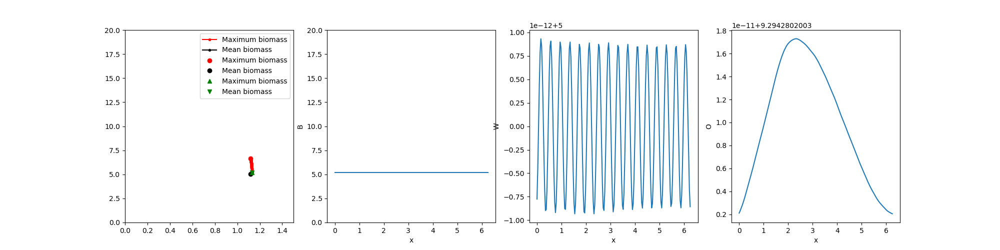

In [583]:
print(sols4[-1][0])
plot_sols(sols4,-1)

In [585]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

### Seventeenth mode with low rainfall

In [726]:
L=200

valmin = 1.000119
valmax = 1.02
n_lmb=17
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0157385680197182


199.99999999478365
0.5340707511241943


Text(0, 0.5, 'O')

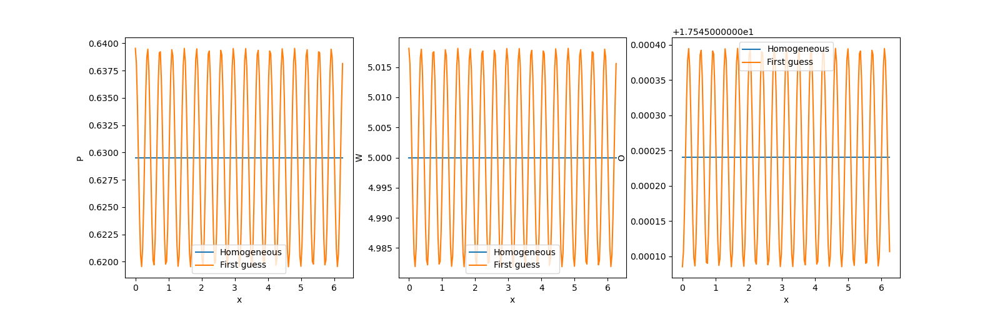

In [727]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [728]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='seventeen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999478365
2.7732326568497e-07 9.975498388705923e-11


1.0157285680197181


Text(0, 0.5, 'O')

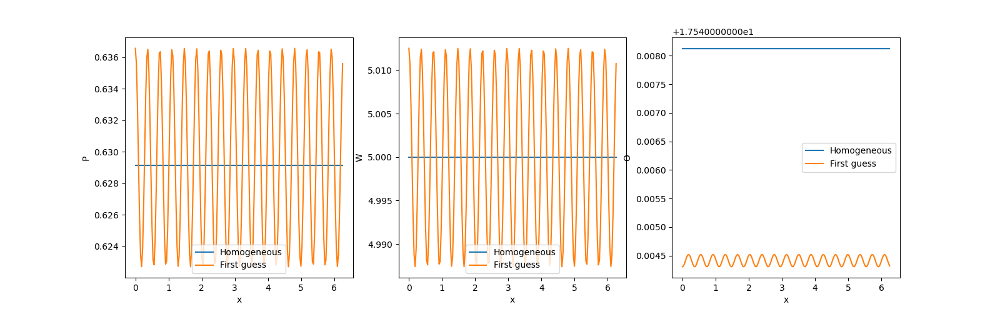

In [729]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [730]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 0.98:
    Rain = Rain-0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999999478365


()

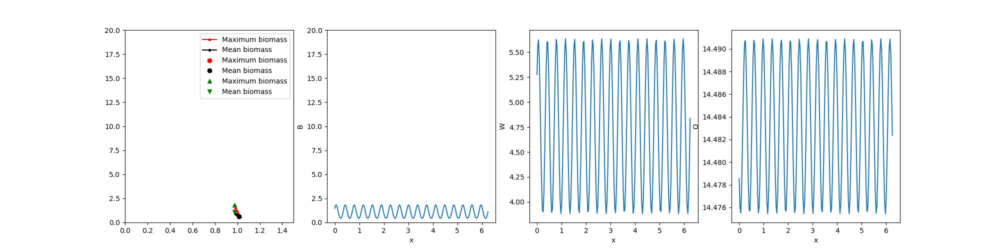

In [731]:
plot_sols(sols,-1)

In [732]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [735]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain - 0.00
Pg = Pg + 0.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


0.9757285680197181


In [736]:
Rain,Pg,Wg,Og = sols2[0]
while Rain > 0.968:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999478365


()

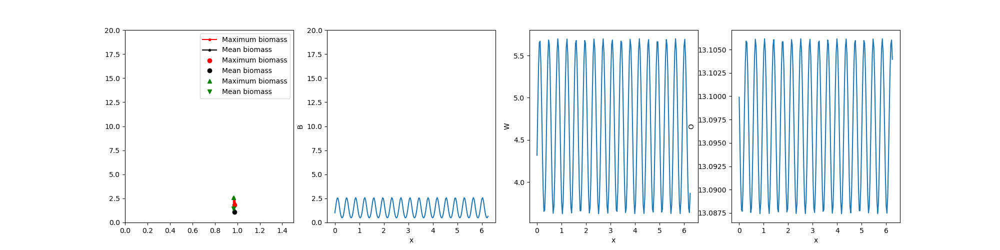

In [737]:
plot_sols(sols2,-1)

In [738]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [742]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.0001
Pg = Pg + 12
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


0.9678285680197181


In [743]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 0.97:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999478365


()

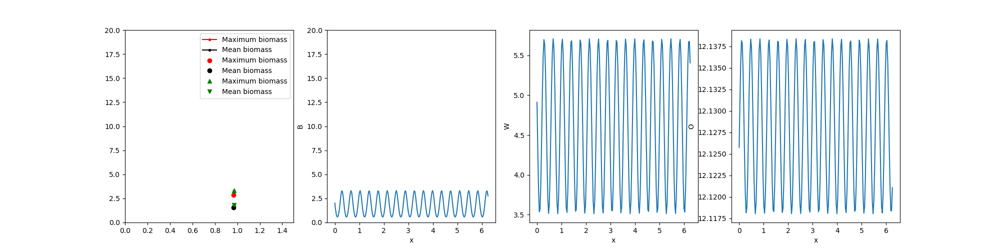

In [745]:
plot_sols(sols3,-1)

In [746]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))

In [749]:
Rain,Pg,Wg,Og = sols3[-1]
Rain = Rain + 0.00
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols4 = [[Rain,Pnew,Wnew,Onew]]


0.9708285680197181


In [750]:
Rain,Pg,Wg,Og = sols4[0]
while Rain < 1.09:
    Rain = Rain+0.01
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-11)
    sols4.append([Rain,Pg,Wg,Og])


199.99999999478365


()

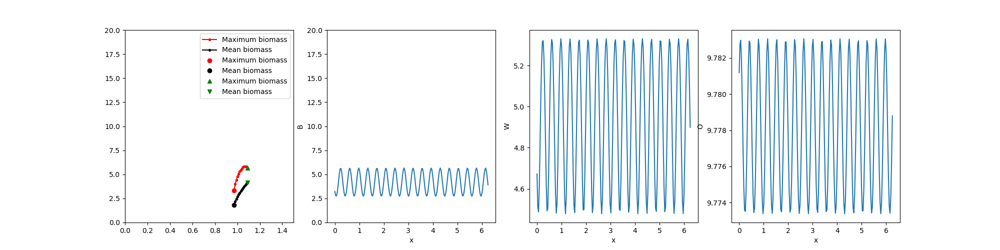

In [751]:
plot_sols(sols4,-1)

In [752]:
save_RvsPWO(sols4,'sols4','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols4,'sols4','O',mode+'R0',int(np.round(L)))

In [756]:
Rain,Pg,Wg,Og = sols4[-1]
Rain = Rain - 0.00
Pg = Pg - 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols5 = [[Rain,Pnew,Wnew,Onew]]


1.090828568019718


In [757]:
Rain,Pg,Wg,Og = sols5[0]
while Rain < 1.112:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols5.append([Rain,Pg,Wg,Og])


199.99999999478365


()

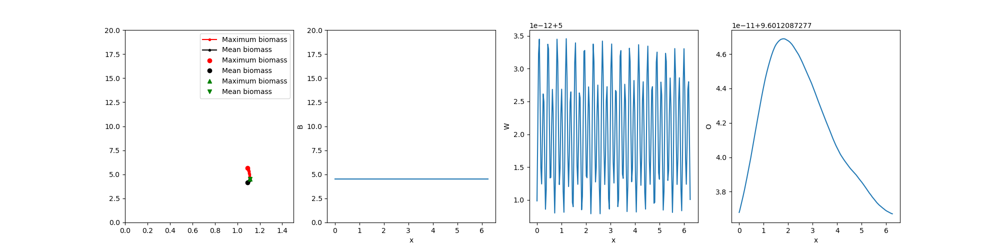

In [758]:
plot_sols(sols5,-1)

In [759]:
save_RvsPWO(sols5,'sols5','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols5,'sols5','O',mode+'R0',int(np.round(L)))

### Eigthteenth mode with low rainfall


In [587]:
L=200

valmin = 1.02
valmax = 1.025
n_lmb=18
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.021344927297905


199.99999999992528
0.5654866776463741


Text(0, 0.5, 'O')

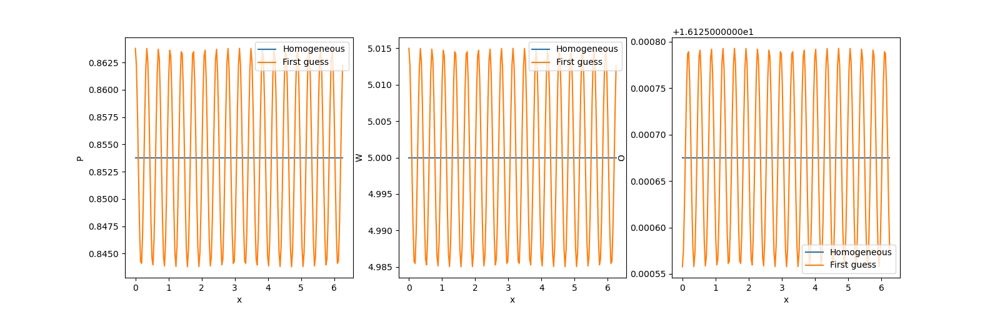

In [588]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [589]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='eighteen'
Rain = Rain-0.00001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999992528
2.5276190029899226e-07 9.356060004292573e-11


1.0213349272979049


Text(0, 0.5, 'O')

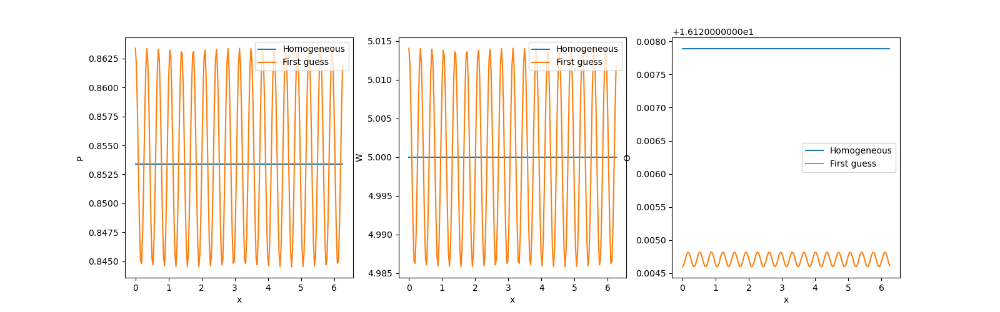

In [590]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [591]:
Rain = Rain-0.0001
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 1.001:
    Rain = Rain-0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


eighteen
199.99999999992528


()

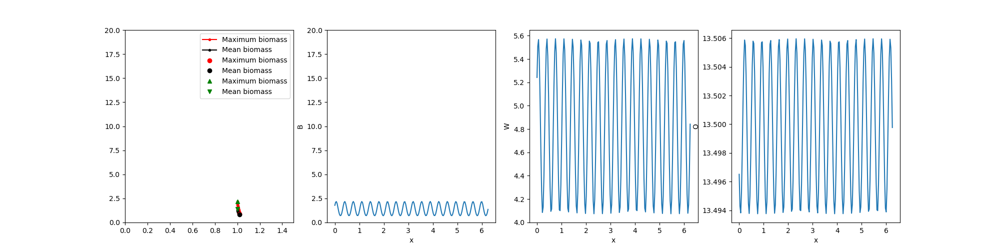

In [642]:
print(mode)
plot_sols(sols,-1)

In [593]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [654]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.0001
Pg = Pg + 0.9
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)

print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


1.0003349272979072


In [655]:
Rain,Pg,Wg,Og = sols2[0]
while Rain < 1.1:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-5,crit_source = 1e-7)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999992528


()

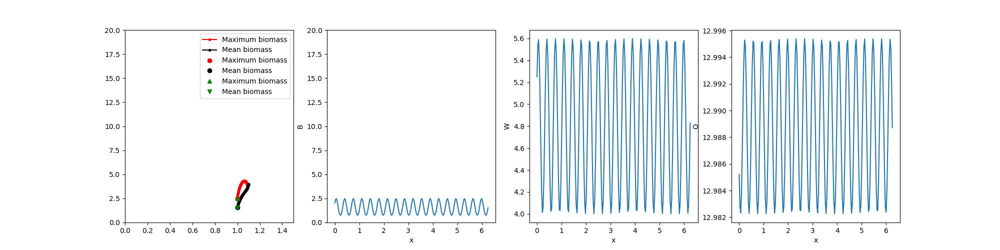

In [656]:
plot_sols(sols2,0)

In [561]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

### Nineteenth mode with low rainfall


In [853]:
L=200

valmin = 1.000119
valmax = 1.1
n_lmb=19
R=find_kappa_U(L,n_lmb,valmin,valmax,kappa)
print(R)
#R2=find_kappa_U(L,3,valmin,valmax,kappa)
#print(R2)

N=200

1.0344587821964923


199.99999999415482
0.5969026041995057


Text(0, 0.5, 'O')

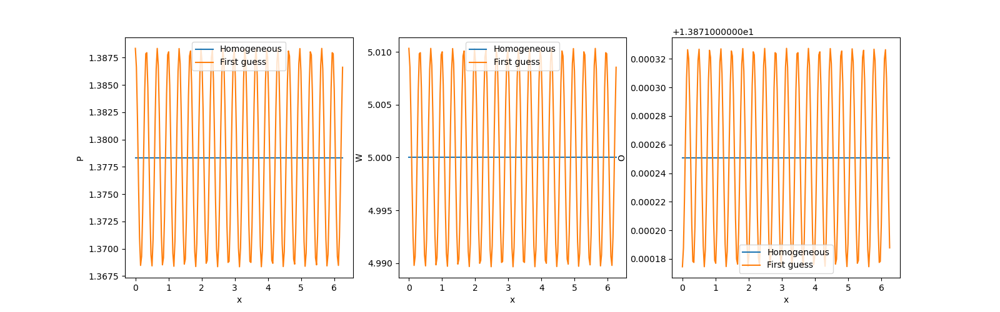

In [854]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
print(L)
print(k)
Ph,Wh,Oh=homogeneous(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [855]:
Rain,L,N,D2,x,Pg,Wg,Og,k = initialGuess(R,kappa,mode="U",n_lmb=n_lmb,eps=0.01,N=N)
mode='nineteen'
Rain = Rain-0.000001
Pg=Pg
print(L)
#Ph,Wh,Oh = homogeneous(Rain)
eps_newton = 0.01; # initial ϵ_newton
for it in range(600):
    Pnew,Wnew,Onew = newton(L,N,Rain,Pg,Wg,Og,eps_newton,param)
    delta_list = [np.max(np.abs(Pnew - Pg)),np.max(np.abs(Wnew - Wg)),np.max(np.abs(Onew - Og))]
    max_update = np.max(delta_list)
    source = static_eqs(L,N,Rain,Pnew,Wnew,Onew,param)
    max_source = np.abs(np.sum(source)/(3*N))
    if max_update < 1e-6 and max_source < 1e-10:
        print(max_update, max_source)
        break
    elif it>=30 and max_update<0.1:
        eps_newton = 0.1
    elif it>=50 and max_update<0.01:
        eps_newton = 1.0
    #elseif it>=50 && max_update<0.001
    #    ϵ_newton = 1.1
    elif max_update > 10:
        print(max_update, max_source)
        print("failed")
        break
    Pg, Wg, Og = Pnew, Wnew, Onew

199.99999999415482
9.396027156327591e-07 1.7830768789118915e-12


1.0344577821964924


Text(0, 0.5, 'O')

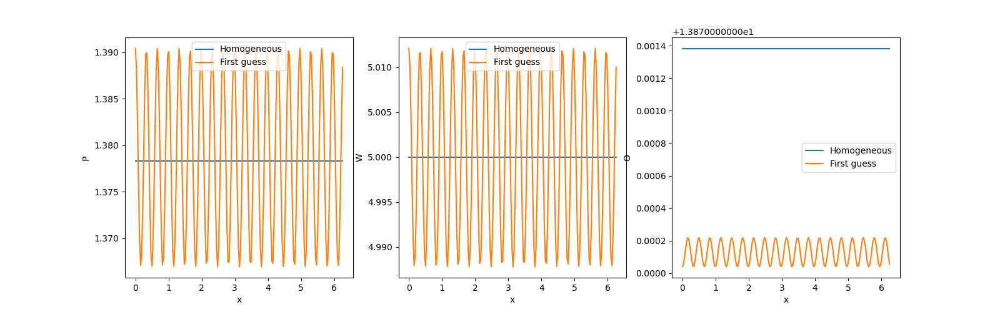

In [856]:
Ph,Wh,Oh=homogeneous(Rain)
print(Rain)
fig,ax=plt.subplots(1,3,figsize=(16,5))
ax[0].plot(x,Ph*np.ones(N),label='Homogeneous')
ax[0].plot(x,Pg,label='First guess')
ax[0].legend()
ax[0].set_xlabel('x')
ax[0].set_ylabel('P')
ax[1].plot(x,Wh*np.ones(N),label='Homogeneous')
ax[1].plot(x,Wg,label='First guess')
ax[1].legend()
ax[1].set_xlabel('x')
ax[1].set_ylabel('W')
ax[2].plot(x,Oh*np.ones(N),label='Homogeneous')
ax[2].plot(x,Og,label='First guess')
ax[2].legend()
ax[2].set_xlabel('x')
ax[2].set_ylabel('O')

In [857]:
Rain = Rain-0.000
#Pg=P
#Wg=W
#Og=O

sols = [[Rain,Pg,Wg,Og]]
while Rain > 1.0343:
    Rain = Rain-0.00001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og)
    sols.append([Rain,Pg,Wg,Og])


199.99999999415482


()

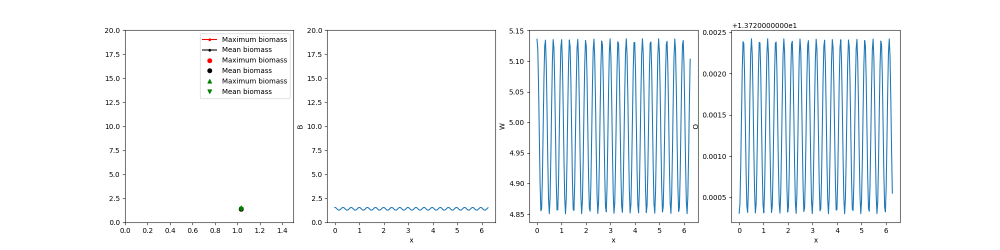

In [859]:
plot_sols(sols,-1)

In [860]:
save_RvsPWO(sols,'sols1','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols,'sols1','O',mode+'R0',int(np.round(L)))

In [865]:
Rain,Pg,Wg,Og = sols[-1]
Rain = Rain + 0.0001
Pg = Pg + 2.0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols2 = [[Rain,Pnew,Wnew,Onew]]


1.0343977821964914


In [866]:
Rain,Pg,Wg,Og = sols2[0]
while Rain < 1.0345:
    Rain = Rain+0.00001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols2.append([Rain,Pg,Wg,Og])


199.99999999415482


()

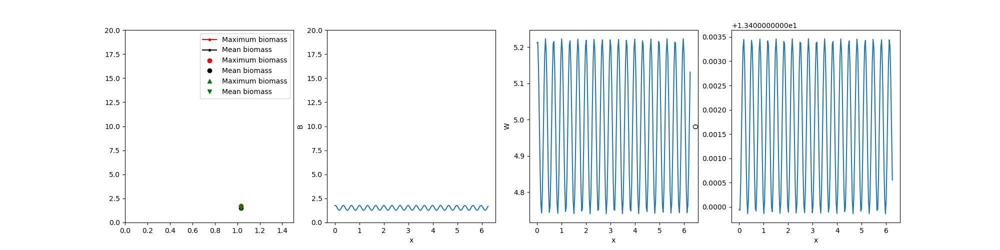

In [868]:
plot_sols(sols2,-1)

In [869]:
save_RvsPWO(sols2,'sols2','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols2,'sols2','O',mode+'R0',int(np.round(L)))

In [875]:
Rain,Pg,Wg,Og = sols2[-1]
Rain = Rain + 0.000
Pg = Pg + 0
Rain,Pnew,Wnew,Onew = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-6,crit_source = 1e-10)
print(Rain)
sols3 = [[Rain,Pnew,Wnew,Onew]]


1.034507782196492


In [876]:
Rain,Pg,Wg,Og = sols3[0]
while Rain < 1.06:
    Rain = Rain+0.001
    Rain,Pg,Wg,Og = newton_iterate(500,Rain,L,param,Pg,Wg,Og,crit_update = 1e-4,crit_source = 1e-6)
    sols3.append([Rain,Pg,Wg,Og])


199.99999999415482


()

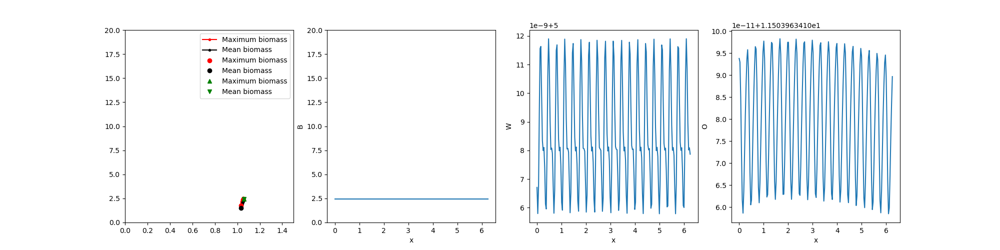

In [877]:
plot_sols(sols3,-1)

In [878]:
save_RvsPWO(sols3,'sols3','P',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','W',mode+'R0',int(np.round(L)))
save_RvsPWO(sols3,'sols3','O',mode+'R0',int(np.round(L)))